# AIRBNB - FINAL PROJECT

### 1. Import libraries

In [1]:
import pandas as pd
import numpy as np
import re
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd

### 2. Import dataset

In [2]:
pd.set_option('display.max_columns', None)

In [3]:
listings = pd.read_csv('raw_listings.csv')

In [4]:
listings.head(5)

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,3176,https://www.airbnb.com/rooms/3176,20221221170323,2022-12-22,city scrape,Fabulous Flat in great Location,This beautiful first floor apartment is situa...,The neighbourhood is famous for its variety of...,https://a0.muscache.com/pictures/243355/84afcf...,3718,https://www.airbnb.com/users/show/3718,Britta,2008-10-19,"Coledale, Australia",We love to travel ourselves a lot and prefer t...,within a few hours,100%,40%,f,https://a0.muscache.com/im/users/3718/profile_...,https://a0.muscache.com/im/users/3718/profile_...,Prenzlauer Berg,1.0,1.0,"['email', 'phone']",t,t,"Berlin, Germany",Prenzlauer Berg Südwest,Pankow,52.53471,13.41810,Entire rental unit,Entire home/apt,4,NaN,1 bath,1.0,2.0,"[""Smoke alarm"", ""Kitchen"", ""Private hot tub"", ...",$83.00,63,184,63,63,184,184,63.0,184.0,NaN,t,3,3,5,280,2022-12-22,147,0,0,2009-06-20,2021-01-01,4.63,4.68,4.53,4.64,4.69,4.92,4.63,First name and Last name: Nicolas Krotz Conta...,f,1,1,0,0,0.89
1,9991,https://www.airbnb.com/rooms/9991,20221221170323,2022-12-22,city scrape,Geourgeous flat - outstanding views,4 bedroom with very large windows and outstand...,Prenzlauer Berg is an amazing neighbourhood wh...,https://a0.muscache.com/pictures/42799131/59c8...,33852,https://www.airbnb.com/users/show/33852,Philipp,2009-08-25,"Berlin, Germany",Born in Munich - lives in and loves Berlin. Wo...,within a day,75%,0%,f,https://a0.muscache.com/im/users/33852/profile...,https://a0.muscache.com/im/users/33852/profile...,Prenzlauer Berg,1.0,1.0,"['email', 'phone']",t,t,"Berlin, Germany",Prenzlauer Berg Südwest,Pankow,52.53269,13.41805,Entire rental unit,Entire home/apt,7,NaN,2.5 baths,4.0,7.0,"[""Smoke alarm"", ""Bed linens"", ""Oven"", ""Kitchen...",$180.00,6,14,6,6,14,14,6.0,14.0,NaN,t,0,0,0,0,2022-12-22,8,0,0,2015-08-09,2020-01-04,5.00,5.00,5.00,5.00,5.00,4.86,4.86,03/Z/RA/003410-18,f,1,1,0,0,0.09
2,57049,https://www.airbnb.com/rooms/57049,20221221170323,2022-12-22,city scrape,130 sqm with a view on Mauer Park,An apartment of 130 sqm right in the heart of ...,Prenzlauer Berg is no doubt one of the most my...,https://a0.muscache.com/pictures/miso/Hosting-...,54283,https://www.airbnb.com/users/show/54283,Marine,2009-11-14,"Berlin, Germany",I'm french but I have been living in Berlin si...,within a few hours,100%,87%,t,https://a0.muscache.com/im/users/54283/profile...,https://a0.muscache.com/im/users/54283/profile...,Prenzlauer Berg,3.0,3.0,"['email', 'phone']",t,t,"Berlin, Germany",Prenzlauer Berg Nordwest,Pankow,52.54758,13.40632,Entire rental unit,Entire home/apt,4,NaN,2 baths,2.0,3.0,"[""Smoke alarm"", ""Bed linens"", ""Oven"", ""Kitchen...",$280.00,3,10,3,3,10,10,3.0,10.0,NaN,t,0,0,13,134,2022-12-22

#### 2.1 Special information
Get some insights into special accommodations, the most expensive and cheapest accommodations

In [5]:
listings_1 = pd.read_csv('raw_listings.csv')

In [6]:
listings_1['price'] = [s.replace('$', '') for s in listings_1['price']]
listings_1['price'] = [s.replace(',', '') for s in listings_1['price']]
listings_1['price'] = listings_1['price'].astype(float)

In [7]:
# Cheapest airbnb
listings_1[listings_1['price']== 8.00]

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
653,2161434,https://www.airbnb.com/rooms/2161434,20221221170323,2022-12-22,previous scrape,Nice room in the heart of Berlin!,I have sometimes to leave my room in Berlin an...,NaN,https://a0.muscache.com/pictures/29320553/c074...,8864348,https://www.airbnb.com/users/show/8864348,Maria,2013-09-16,"Berlin, Germany","courius. i want to learn, research, find, get ...",NaN,NaN,NaN,f,https://a0.muscache.com/im/pictures/user/fc406...,https://a0.muscache.com/im/pictures/user/fc406...,NaN,1.0,7.0,"['email', 'phone']",t,f,NaN,Karl-Marx-Allee-Süd,Friedrichshain-Kreuzberg,52.51215,13.4382,Private room in rental unit,Private room,2,NaN,1.5 baths,1.0,2.0,"[""Kitchen"", ""Washer"", ""Heating"", ""Gym"", ""Long ...",8.0,15,365,15,15,365,365,15.0,365.0,NaN,t,0,0,0,0,2022-12-22,1,0,0,2014-03-26,2014-03-26,5.0,3.0,5.0,4.0,5.0,5.0,5.0,NaN,f,1,0,1,0,0.01


In [8]:
# most expensive airbnb
listings_1[listings_1['price']> 5000 ]

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
1189,3515365,https://www.airbnb.com/rooms/3515365,20221221170323,2022-12-21,city scrape,Nice Flat in the Centre of Berlin,My flat is located in vibrant Moabit. Having t...,Moabit is virtualy an island as it is surround...,https://a0.muscache.com/pictures/db0b1cc7-03b1...,8579279,https://www.airbnb.com/users/show/8579279,Stefan,2013-09-02,"Berlin, Germany","I am a self-exclaimed lover of music, literatu...",within a day,67%,37%,f,https://a0.muscache.com/im/pictures/user/e73c1...,https://a0.muscache.com/im/pictures/user/e73c1...,Moabit,1.0,1.0,"['email', 'phone']",t,t,"Berlin, Germany",Moabit Ost,Mitte,52.52909,13.34518,Entire rental unit,Entire home/apt,2,NaN,1.5 baths,2.0,2.0,"[""Smoke alarm"", ""Bed linens"", ""Oven"", ""Kitchen...",98108.0,2,1125,2,2,1125,1125,2.0,1125.0,NaN,t,19,49,79,354,2022-12-21,26,3,0,2014-09-21,2022-09-07,4.78,4.87,4.17,4.87,4.83,4.87,4.65,NaN,f,1,1,0,0,0.26
10016,37558386,https://www.airbnb.com/rooms/37558386,20221221170323,2022-12-22,city scrape,Souterrainwohnung 9 km vom Flughafen Berlin BER,"Die komplett separate, saubere und gemütliche ...","diverse Restaurants, Supermärkte und sonstige ...",https://a0.muscache.com/pictures/432e1d19-2c67...,283690319,https://www.airbnb.com/users/show/283690319,Sven,2019-08-07,NaN,NaN,within an hour,100%,95%,t,https://a0.muscache.com/im/pictures/user/be97b...,https://a0.muscache.com/im/pictures/user/be97b...,Altglienicke,1.0,1.0,"['email', 'phone']",t,t,"Berlin, Germany",Altglienicke,Treptow - Köpenick,52.41669,13.54766,Entire rental unit,Entire home/apt,2,NaN,1 bath,1.0,1.0,"[""Smoke alarm"", ""Oven"", ""Kitchen"", ""Microwave""...",5878.0,3,1125,3,22,35,1125,4.1,1059.9,NaN,t,3,6,14,229,2022-12-22,79,27,1,2019-08-16,2022-12-05,4.87,4.91,4.68,4.97,4.99,4.77,4.87,NaN,f,1,1,0,0,1.93
13171,52501919,https://www.airbnb.com/rooms/52501919,20221221170323,2022-12-22,city scrape,SCHILLERKIEZ-Cosy&Quiet. Pte Bathroom+Kitchenette,"Kick back and relax in this calm, stylish spac...",NaN,https://a0.muscache.com/pictures/miso/Hosting-...,7977414,https://www.airbnb.com/users/show/7977414,(Website hidden by Airbnb) L,2013-08-06,"Berlin, Germany",Human,within an hour,100%,100%,f,https://a0.muscache.com/im/users/7977414/profi...,https://a0.muscache.com/im/users/7977414/profi...,NaN,7.0,12.0,"['email', 'phone']",t,t,NaN,Schillerpromenade,Neukölln,52.47637,13.42563,Private room in rental unit,Private room,3,NaN,1 private bath,1.0,NaN,"[""Smoke alarm"", ""Bed linens"", ""Kitchen"", ""Show...",64575.0,1,365,1,1,1125,1125,1.0,1125.0,NaN,t,21,49,79,79,2022-12-22,5,4,0,2021-11-02,2022-10-27,3.80,4.40,3.60,4.80,4.60,4.00,3.40,First name and Last name: F.M Paolini Contact...,t,7,1,6,0,0.36


In [9]:
# Special airbnb
listings_1[listings_1['property_type']== 'Island']

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
11161,42090722,https://www.airbnb.com/rooms/42090722,20221221170323,2022-12-21,city scrape,"Großzügiges, helles Loft auf Havel-Insel Eiswe...",Alt trifft neu - Wohnen in einer denkmalgeschü...,"Eiswerder ist ein Kleinod, gelegen in der Have...",https://a0.muscache.com/pictures/dc26001f-3a86...,129770901,https://www.airbnb.com/users/show/129770901,Birgit,2017-05-10,"Berlin, Germany",Wir leben seit einigen Jahren hier und genieße...,within a day,100%,100%,t,https://a0.muscache.com/im/pictures/user/41c20...,https://a0.muscache.com/im/pictures/user/41c20...,NaN,1.0,1.0,"['email', 'phone']",t,t,"Berlin, Germany",Spandau Mitte,Spandau,52.54848,13.2185,Island,Entire home/apt,2,NaN,1 bath,1.0,2.0,"[""Smoke alarm"", ""Bed linens"", ""Kitchen"", ""Show...",110.0,3,14,3,3,14,14,3.0,14.0,NaN,t,18,38,66,66,2022-12-21,30,11,0,2020-07-10,2022-10-12,5.0,5.0,5.0,5.0,5.0,4.87,4.97,05/Z/AZ/007691-20,f,1,1,0,0,1.01


In [10]:
listings_1['neighbourhood_cleansed'].value_counts()

Alexanderplatz                        929
Frankfurter Allee Süd FK              869
Tempelhofer Vorstadt                  788
Reuterstraße                          625
Brunnenstr. Süd                       618
                                     ... 
Allende-Viertel                         2
Forst Grunewald                         2
Hellersdorf-Süd                         2
Marzahn-Nord                            2
Malchow, Wartenberg und Falkenberg      1
Name: neighbourhood_cleansed, Length: 138, dtype: int64

In [11]:
postal_code = pd.DataFrame(listings_1['neighbourhood_cleansed'])
postal_code.value_counts()

neighbourhood_cleansed            
Alexanderplatz                        929
Frankfurter Allee Süd FK              869
Tempelhofer Vorstadt                  788
Reuterstraße                          625
Brunnenstr. Süd                       618
                                     ... 
Forst Grunewald                         2
Marzahn-Nord                            2
Hellersdorf-Süd                         2
Allende-Viertel                         2
Malchow, Wartenberg und Falkenberg      1
Length: 138, dtype: int64

### 3. Data Cleaning

#### 3.1 Drop columns 
- Will not be needed for this analysis

In [12]:
# Which columns can be dropped 
listings = listings.drop(['scrape_id', 'last_scraped', 'source', 'description', 'neighborhood_overview', 'picture_url', 'host_location', 'host_name', 'host_url', 'host_about', 'host_thumbnail_url', 'host_picture_url', 'bathrooms', 'minimum_minimum_nights', 'maximum_minimum_nights', 'minimum_maximum_nights', 'maximum_maximum_nights', 'calendar_updated', 'has_availability', 'calendar_last_scraped', 'number_of_reviews_ltm', 'number_of_reviews_l30d', 'first_review', 'last_review', 'calculated_host_listings_count','host_total_listings_count','host_has_profile_pic','host_identity_verified', 'calculated_host_listings_count_entire_homes', 'calculated_host_listings_count_private_rooms', 'calculated_host_listings_count_shared_rooms'], axis = 1)

In [13]:
listings.head(2)

,id,listing_url,name,host_id,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_neighbourhood,host_listings_count,host_verifications,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,availability_30,availability_60,availability_90,availability_365,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,reviews_per_month
0,3176,https://www.airbnb.com/rooms/3176,Fabulous Flat in great Location,3718,2008-10-19,within a few hours,100%,40%,f,Prenzlauer Berg,1.0,"['email', 'phone']","Berlin, Germany",Prenzlauer Berg Südwest,Pankow,52.53471,13.41810,Entire rental unit,Entire home/apt,4,1 bath,1.0,2.0,"[""Smoke alarm"", ""Kitchen"", ""Private hot tub"", ...",$83.00,63,184,63.0,184.0,3,3,5,280,147,4.63,4.68,4.53,4.64,4.69,4.92,4.63,First name and Last name: Nicolas Krotz Conta...,f,0.89
1,9991,https://www.airbnb.com/rooms/9991,Geourgeous flat - outstanding views,33852,2009-08-25,within a day,75%,0%,f,Prenzlauer Berg,1.0,"['email', 'phone']","Berlin, Germany",Prenzlauer Berg Südwest,Pankow,52.53269,13.41805,Entire rental unit,Entire home/apt,7,2.5 baths,4.0,7.0,"[""Smoke alarm"", ""Bed linens"", ""Oven"", ""Kitchen...",$180.00,6,14,6.0,14.0,0,0,0,0,8,5.00,5.00,5.00,5.00,5.00,4.86,4.86,03/Z/RA/003410-18,f,0.09


In [14]:
listings = listings.drop(['id', 'listing_url', 'name', 'host_id', 'host_since','host_response_time', 'host_response_rate', 'host_acceptance_rate','host_neighbourhood', 'host_listings_count', 'host_verifications','minimum_nights_avg_ntm', 'maximum_nights_avg_ntm', 'license', 'reviews_per_month'], axis = 1)
listings.head(2)

,host_is_superhost,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable
0,f,"Berlin, Germany",Prenzlauer Berg Südwest,Pankow,52.53471,13.41810,Entire rental unit,Entire home/apt,4,1 bath,1.0,2.0,"[""Smoke alarm"", ""Kitchen"", ""Private hot tub"", ...",$83.00,63,184,3,3,5,280,147,4.63,4.68,4.53,4.64,4.69,4.92,4.63,f
1,f,"Berlin, Germany",Prenzlauer Berg Südwest,Pankow,52.53269,13.41805,Entire rental unit,Entire home/apt,7,2.5 baths,4.0,7.0,"[""Smoke alarm"", ""Bed linens"", ""Oven"", ""Kitchen...",$180.00,6,14,0,0,0,0,8,5.00,5.00,5.00,5.00,5.00,4.86,4.86,f


In [15]:
listings.isna().sum()

host_is_superhost                  4
neighbourhood                   7529
neighbourhood_cleansed             0
neighbourhood_group_cleansed       0
latitude                           0
longitude                          0
property_type                      0
room_type                          0
accommodates                       0
bathrooms_text                    14
bedrooms                        1293
beds                             302
amenities                          0
price                              0
minimum_nights                     0
maximum_nights                     0
availability_30                    0
availability_60                    0
availability_90                    0
availability_365                   0
number_of_reviews                  0
review_scores_rating            2962
review_scores_accuracy          3207
review_scores_cleanliness       3204
review_scores_checkin           3212
review_scores_communication     3204
review_scores_location          3211
r

In [16]:
listings.isna().sum()/len(listings)

host_is_superhost               0.000255
neighbourhood                   0.479035
neighbourhood_cleansed          0.000000
neighbourhood_group_cleansed    0.000000
latitude                        0.000000
longitude                       0.000000
property_type                   0.000000
room_type                       0.000000
accommodates                    0.000000
bathrooms_text                  0.000891
bedrooms                        0.082268
beds                            0.019215
amenities                       0.000000
price                           0.000000
minimum_nights                  0.000000
maximum_nights                  0.000000
availability_30                 0.000000
availability_60                 0.000000
availability_90                 0.000000
availability_365                0.000000
number_of_reviews               0.000000
review_scores_rating            0.188458
review_scores_accuracy          0.204047
review_scores_cleanliness       0.203856
review_scores_ch

In [17]:
# Drop columns that have too many missing values
display(listings.neighbourhood.value_counts(dropna=False))
listings.neighbourhood_cleansed.value_counts()

Berlin, Germany                                8148
NaN                                            7529
Berlin - Mitte, Germany                           3
Berlin, Be, Germany                               2
Potsdam, Brandenburg, Germany                     2
Germany                                           2
Berlin , Germany                                  2
Berlin, SN, Germany                               1
Berlin, neukoelln, Germany                        1
Berlin, Berlin, DE, Berlin, Germany               1
Hoppegarten, Brandenburg, Germany                 1
Schöneiche bei Berlin, Brandenburg, Germany       1
Mitte, Berlin, Germany                            1
Berlin, DE, Germany                               1
Berlin-Bohnsdorf, Germany                         1
Berlin, Berlín, Germany                           1
柏林, Germany                                       1
Berlin Prenzlauer Berg , Berlin, Germany          1
Weissensee, Berlin, Germany                       1
Weissenhoher

Alexanderplatz                        929
Frankfurter Allee Süd FK              869
Tempelhofer Vorstadt                  788
Reuterstraße                          625
Brunnenstr. Süd                       618
                                     ... 
Allende-Viertel                         2
Forst Grunewald                         2
Hellersdorf-Süd                         2
Marzahn-Nord                            2
Malchow, Wartenberg und Falkenberg      1
Name: neighbourhood_cleansed, Length: 138, dtype: int64

In [18]:
# Drop neighbourhood as it doesn't give much detail and other columns explain it better
listings = listings.drop(['neighbourhood'], axis =1)

#### 3.2. Check for Nans and clean columns

In [19]:
listings.isna().sum()

host_is_superhost                  4
neighbourhood_cleansed             0
neighbourhood_group_cleansed       0
latitude                           0
longitude                          0
property_type                      0
room_type                          0
accommodates                       0
bathrooms_text                    14
bedrooms                        1293
beds                             302
amenities                          0
price                              0
minimum_nights                     0
maximum_nights                     0
availability_30                    0
availability_60                    0
availability_90                    0
availability_365                   0
number_of_reviews                  0
review_scores_rating            2962
review_scores_accuracy          3207
review_scores_cleanliness       3204
review_scores_checkin           3212
review_scores_communication     3204
review_scores_location          3211
review_scores_value             3213
i

In [20]:
# Check rows and how much information they are missing
listings['n_missing'] = listings.isna().sum(axis=1)

In [21]:
listings['n_missing'].value_counts().sort_values()

5         2
11        2
3         4
4         5
9        14
2        30
6       205
8       311
1      1168
7      2670
0     11306
Name: n_missing, dtype: int64

In [22]:
listings.head(2)

,host_is_superhost,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,n_missing
0,f,Prenzlauer Berg Südwest,Pankow,52.53471,13.41810,Entire rental unit,Entire home/apt,4,1 bath,1.0,2.0,"[""Smoke alarm"", ""Kitchen"", ""Private hot tub"", ...",$83.00,63,184,3,3,5,280,147,4.63,4.68,4.53,4.64,4.69,4.92,4.63,f,0
1,f,Prenzlauer Berg Südwest,Pankow,52.53269,13.41805,Entire rental unit,Entire home/apt,7,2.5 baths,4.0,7.0,"[""Smoke alarm"", ""Bed linens"", ""Oven"", ""Kitchen...",$180.00,6,14,0,0,0,0,8,5.00,5.00,5.00,5.00,5.00,4.86,4.86,f,0


In [23]:
listings.dtypes

host_is_superhost                object
neighbourhood_cleansed           object
neighbourhood_group_cleansed     object
latitude                        float64
longitude                       float64
property_type                    object
room_type                        object
accommodates                      int64
bathrooms_text                   object
bedrooms                        float64
beds                            float64
amenities                        object
price                            object
minimum_nights                    int64
maximum_nights                    int64
availability_30                   int64
availability_60                   int64
availability_90                   int64
availability_365                  int64
number_of_reviews                 int64
review_scores_rating            float64
review_scores_accuracy          float64
review_scores_cleanliness       float64
review_scores_checkin           float64
review_scores_communication     float64


##### host_is_superhost

In [24]:
listings['host_is_superhost'].value_counts()

f    13364
t     2349
Name: host_is_superhost, dtype: int64

In [25]:
listings['host_is_superhost'] = listings['host_is_superhost'].fillna('f')

##### neighbourhood_cleansed


In [26]:
listings['neighbourhood_cleansed'].value_counts()

Alexanderplatz                        929
Frankfurter Allee Süd FK              869
Tempelhofer Vorstadt                  788
Reuterstraße                          625
Brunnenstr. Süd                       618
                                     ... 
Allende-Viertel                         2
Forst Grunewald                         2
Hellersdorf-Süd                         2
Marzahn-Nord                            2
Malchow, Wartenberg und Falkenberg      1
Name: neighbourhood_cleansed, Length: 138, dtype: int64

##### neighbourhood_group_cleansed

In [27]:
listings['neighbourhood_group_cleansed'].value_counts()

Friedrichshain-Kreuzberg    3516
Mitte                       3426
Pankow                      2480
Neukölln                    2103
Charlottenburg-Wilm.        1287
Tempelhof - Schöneberg      1066
Treptow - Köpenick           543
Lichtenberg                  463
Steglitz - Zehlendorf        362
Reinickendorf                231
Spandau                      130
Marzahn - Hellersdorf        110
Name: neighbourhood_group_cleansed, dtype: int64

In [28]:
# drop neighbourhood_cleansed as neighbourhood_group_cleansed provides better information
listings = listings.drop(['neighbourhood_cleansed'], axis = 1)

##### property type

In [29]:
listings['property_type'].value_counts()

Entire rental unit             7561
Private room in rental unit    4818
Entire condo                    759
Entire serviced apartment       420
Entire loft                     325
                               ... 
Island                            1
Private room in tipi              1
Private room in floor             1
Private room in cottage           1
Casa particular                   1
Name: property_type, Length: 66, dtype: int64

##### room_type

In [30]:
listings['room_type'].value_counts()

Entire home/apt    9496
Private room       5887
Shared room         189
Hotel room          145
Name: room_type, dtype: int64

In [31]:
# Drop property_type as feature room_type provides a grouped overview of the differnet types
listings = listings.drop(['property_type'], axis = 1)

##### accommodates

In [32]:
listings['accommodates'].value_counts()

2     8113
4     2447
1     1814
3     1686
6      648
5      532
8      153
7      133
10      49
12      41
9       38
16      21
14      14
11      12
13      11
0        3
15       2
Name: accommodates, dtype: int64

In [33]:
# Get rid of the accommodations that don't host anyone
listings = listings[listings['accommodates']!= 0]

In [34]:
listings['accommodates'].value_counts()

2     8113
4     2447
1     1814
3     1686
6      648
5      532
8      153
7      133
10      49
12      41
9       38
16      21
14      14
11      12
13      11
15       2
Name: accommodates, dtype: int64

##### Bedrooms

In [35]:
# Assign number of bedrooms to the most common one

listings.bedrooms.value_counts(dropna=False)

1.0     11331
2.0      2267
NaN      1290
3.0       628
4.0       147
5.0        37
6.0         8
7.0         3
10.0        1
12.0        1
9.0         1
Name: bedrooms, dtype: int64

In [36]:
listings[listings['bedrooms'].isna()].head(50)

,host_is_superhost,neighbourhood_group_cleansed,latitude,longitude,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,n_missing
3,t,Pankow,52.54813,13.40366,Entire home/apt,1,1 bath,NaN,1.0,"[""Smoke alarm"", ""Dishes and silverware"", ""Host...",$70.00,93,1125,0,2,2,139,26,4.67,5.00,4.84,4.68,4.84,4.58,4.42,f,1
16,f,Neukölln,52.49419,13.42166,Entire home/apt,2,1 bath,NaN,1.0,"[""Iron"", ""Dishes and silverware"", ""Coffee make...",$25.00,92,365,0,0,0,203,299,4.77,4.82,4.71,4.89,4.92,4.87,4.65,f,1
17,t,Pankow,52.55004,13.41518,Entire home/apt,4,1 bath,NaN,2.0,"[""Bed linens"", ""Oven"", ""Kitchen"", ""Microwave"",...",$124.00,3,200,17,36,66,341,348,4.58,4.74,4.63,4.68,4.73,4.82,4.55,f,1
27,t,Charlottenburg-Wilm.,52.48074,13.28903,Entire home/apt,1,1 bath,NaN,1.0,"[""Smoke alarm"", ""Bed linens"", ""Oven"", ""Kitchen...",$86.00,2,330,29,59,89,99,137,4.94,4.98,5.00,4.97,4.99,4.83,4.88,f,1
30,t,Neukölln,52.44127,13.46116,Entire home/apt,3,1 bath,NaN,1.0,"[""Smoke alarm"", ""Host greets you"", ""Shared bac...",$58.00,4,365,6,13,39,275,46,4.80,4.89,4.76,4.96,4.96,4.44,4.76,t,1
41,t,Mitte,52.52826,13.33044,Entire home/apt,4,1 bath,NaN,1.0,"[""Smoke alarm"", ""Oven"", ""Kitchen"", ""Baking she...",$60.00,2,365,12,22,33,206,184,4.59,4.80,4.53,4.87,4.84,4.46,4.63,t,1
48,t,Pankow,52.54804,13.40349,Entire home/apt,1,1 bath,NaN,1.0,"[""Smoke alarm"", ""Dishes and silverware"", ""Host...",$70.00,93,1125,0,0,0,228,34,4.66,4.75,4.84,4.88,4.97,4.69,4.26,f,1
71,f,Tempelhof - Schöneberg,52.48538,13.34681,Entire home/apt,3,1 bath,NaN,1.0,"[""Smoke alarm"", ""Bed linens"", ""Oven"", ""Kitchen...",$80.00,5,365,21,51,81,188,23,4.48,4.87,4.39,4.96,5.00,4.91,4.57,t,1
90,t,Friedrichshain-Kreuzberg,52.50786,13.46703,Entire home/apt,4,1 bath,NaN,2.0,"[""Smoke alarm"", ""Bed linens"", ""Kitchen"", ""Show...",$63.00,2,92,17,38,68,155,248,4.55,4.74,4.62,4.66,4.77,4.78,4.55,t,1
106,t,Pankow,52.53949,13.41615,Entire home/apt,2,1.5 baths,NaN,3.0,"[""Smoke alarm"", ""Bed linens"", ""Kitchen"", ""City...",$94.00,1,1125,26,56,86,86,211,4.78,4.85,4.90,4.83,4.90,4.90,4.56,t,1


<AxesSubplot:xlabel='bedrooms', ylabel='count'>

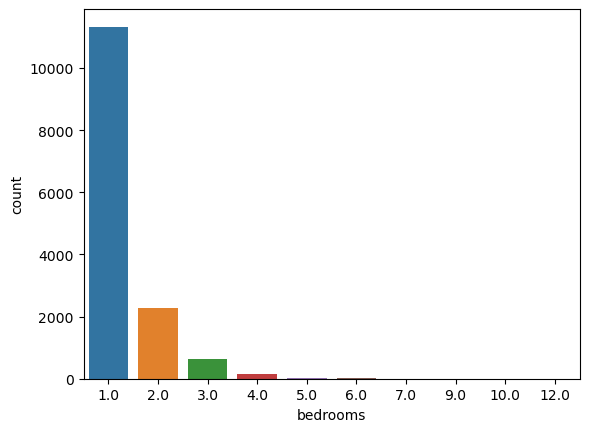

In [37]:
sns.countplot(x=listings["bedrooms"])

In [38]:
mean_bedr=listings.bedrooms.mean()
mean_bedr

1.291042706600111

In [39]:
# Assign missing values to 1 rounded from the mean bedrooms 
listings['bedrooms'] = listings['bedrooms'].fillna(1)

In [40]:
listings.bedrooms.value_counts(dropna=False)

1.0     12621
2.0      2267
3.0       628
4.0       147
5.0        37
6.0         8
7.0         3
10.0        1
12.0        1
9.0         1
Name: bedrooms, dtype: int64

In [41]:
listings['bedrooms'] = listings['bedrooms'].astype(int)

In [42]:
# Drop the rows with more than 5 bedrooms
listings = listings[listings['bedrooms']<6]

In [43]:
listings.bedrooms.value_counts(dropna=False)

1    12621
2     2267
3      628
4      147
5       37
Name: bedrooms, dtype: int64

##### Beds

In [44]:
listings.beds.value_counts(dropna=False)

1.0     9233
2.0     3737
3.0     1179
4.0      628
NaN      299
5.0      254
6.0      199
7.0       62
8.0       51
10.0      16
9.0       15
11.0      10
12.0       7
16.0       4
14.0       3
22.0       1
17.0       1
13.0       1
Name: beds, dtype: int64

In [45]:
# get rid of the outliers
listings = listings[listings['beds']<9]

<AxesSubplot:xlabel='beds', ylabel='count'>

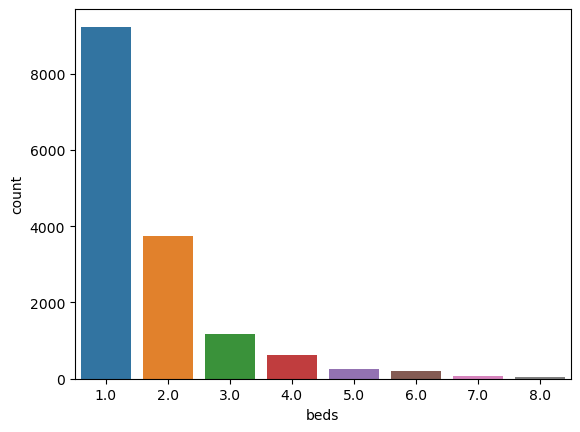

In [46]:
sns.countplot(x=listings["beds"])

In [47]:
mean_beds = listings.beds.mean()
mean_beds

1.6986247800299812

In [48]:
# Assign missing values to 2 rounded from the mean 
listings['beds'] = listings['beds'].fillna(2)

In [49]:
listings['beds'] = listings['beds'].astype(int)

##### amenities

In [50]:
listings.amenities

0        ["Smoke alarm", "Kitchen", "Private hot tub", ...
1        ["Smoke alarm", "Bed linens", "Oven", "Kitchen...
2        ["Smoke alarm", "Bed linens", "Oven", "Kitchen...
3        ["Smoke alarm", "Dishes and silverware", "Host...
4        ["Bed linens", "TV with standard cable", "Dish...
                               ...                        
15712    ["Kitchen", "Washer", "TV", "Long term stays a...
15713    ["Smoke alarm", "Bed linens", "Oven", "Kitchen...
15714    ["Smoke alarm", "Bed linens", "Oven", "Kitchen...
15715    ["Smoke alarm", "Exercise equipment", "Free pa...
15716    ["Smoke alarm", "Kitchen", "Washer", "Long ter...
Name: amenities, Length: 15343, dtype: object

In [51]:
# Delete not essential for this analysis
listings = listings.drop(['amenities'], axis = 1)

##### price

In [52]:
listings.price.value_counts()

$50.00     586
$40.00     522
$30.00     489
$60.00     463
$45.00     450
          ... 
$410.00      1
$570.00      1
$356.00      1
$685.00      1
$550.00      1
Name: price, Length: 473, dtype: int64

In [53]:
listings['price'] = [s.replace('$', '') for s in listings['price']]
listings['price'] = [s.replace(',', '') for s in listings['price']]

In [54]:
listings['price'] = listings['price'].astype(float)
listings['price'].mean()

98.2633507136805

<AxesSubplot:xlabel='price'>

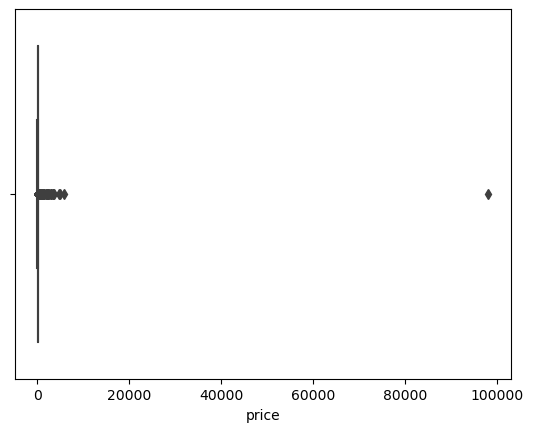

In [55]:
sns.boxplot(x=listings['price'])

In [56]:
listings[listings['price']>500]

,host_is_superhost,neighbourhood_group_cleansed,latitude,longitude,room_type,accommodates,bathrooms_text,bedrooms,beds,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,n_missing
302,t,Mitte,52.512060,13.417540,Entire home/apt,2,1 bath,1,1,1215.0,1,1125,3,11,11,42,400,4.80,4.81,4.86,4.82,4.83,4.71,4.72,f,0
633,f,Mitte,52.527460,13.407810,Entire home/apt,4,2 baths,3,3,543.0,120,120,7,7,7,7,14,5.00,4.92,5.00,5.00,5.00,5.00,4.92,f,0
821,f,Friedrichshain-Kreuzberg,52.491850,13.419610,Entire home/apt,15,2 baths,1,1,2500.0,1,1125,29,59,89,89,19,5.00,4.93,5.00,5.00,4.93,4.87,4.60,f,1
1189,f,Mitte,52.529090,13.345180,Entire home/apt,2,1.5 baths,2,2,98108.0,2,1125,19,49,79,354,26,4.78,4.87,4.17,4.87,4.83,4.87,4.65,f,0
1228,f,Charlottenburg-Wilm.,52.531290,13.285650,Entire home/apt,2,1.5 baths,4,3,650.0,2,14,0,0,0,265,3,5.00,5.00,5.00,5.00,5.00,5.00,5.00,f,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15114,f,Friedrichshain-Kreuzberg,52.510421,13.465875,Entire home/apt,4,1 bath,2,2,600.0,1,365,2,2,2,38,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7
15332,f,Mitte,52.515400,13.418460,Private room,2,1 bath,1,1,999.0,1,365,0,0,20,295,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,t,7
15334,f,Mitte,52.516930,13.418680,Private room,2,1 bath,1,1,999.0,1,365,30,60,90,365,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,t,7
15637,f,Charlottenburg-Wilm.,52.471520,13.290610,Entire home/apt,8,3.5 baths,5,5,550.0,3,1125,18,44,74,344,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7


In [57]:
listings[listings['price']==0]

,host_is_superhost,neighbourhood_group_cleansed,latitude,longitude,room_type,accommodates,bathrooms_text,bedrooms,beds,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,n_missing


In [58]:
listings = listings[(listings['price']< 500 )& (listings['price']!=0)]

<AxesSubplot:xlabel='price'>

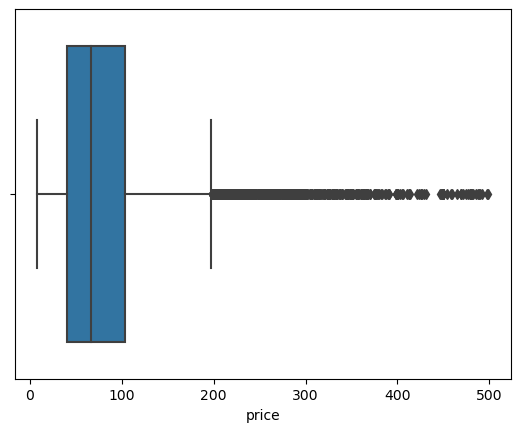

In [59]:
sns.boxplot(x = listings['price'])

In [60]:
extraordinary_prices = listings[listings['price'] > 200]
print(len(extraordinary_prices))

839


In [61]:
extraordinary_prices

,host_is_superhost,neighbourhood_group_cleansed,latitude,longitude,room_type,accommodates,bathrooms_text,bedrooms,beds,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,n_missing
2,t,Pankow,52.547580,13.406320,Entire home/apt,4,2 baths,2,3,280.0,3,10,0,0,13,134,114,4.92,4.95,4.92,4.97,4.92,4.80,4.75,f,0
8,f,Pankow,52.546390,13.406380,Entire home/apt,2,1 bath,1,2,249.0,93,120,7,7,7,272,20,4.75,4.84,4.89,4.68,4.61,4.63,4.58,f,0
36,t,Pankow,52.546770,13.418940,Entire home/apt,6,1.5 baths,2,4,263.0,2,1125,6,31,58,321,360,4.85,4.75,4.78,4.78,4.84,4.89,4.72,f,0
39,t,Pankow,52.544190,13.419560,Entire home/apt,6,1 bath,2,4,280.0,60,180,30,60,90,365,199,4.65,4.63,4.55,4.64,4.73,4.84,4.45,f,0
42,f,Mitte,52.530940,13.334530,Entire home/apt,5,1 bath,1,2,203.0,3,1125,24,54,64,222,49,4.73,4.71,4.88,4.71,4.73,4.61,4.49,t,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15573,f,Mitte,52.538938,13.401895,Entire home/apt,7,2 baths,4,4,280.0,3,6,4,11,11,11,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7
15606,f,Friedrichshain-Kreuzberg,52.508940,13.470380,Entire home/apt,6,1.5 baths,3,3,382.0,3,30,11,11,19,19,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7
15622,t,Pankow,52.537775,13.454703,Entire home/apt,7,3 baths,4,4,320.0,14,90,19,49,79,141,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7
15633,f,Friedrichshain-Kreuzberg,52.518640,13.468650,Entire home/apt,5,1 bath,2,4,427.0,1,365,25,36,36,36,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7


In [62]:
extraordinary_prices_low = listings[listings['price'] < 15]
print(len(extraordinary_prices_low))

98


In [63]:
listings = listings[(listings['price']< 250 )& (listings['price']>10)]

Reduce the dataset by outliers above 250 and below 10 dollars. As mainly all of the other price lie inbetween that dataset.

In [64]:
listings.describe().T

,count,mean,std,min,25%,50%,75%,max
latitude,14719.0,52.509834,0.032630,52.36904,52.489550,52.50944,52.532805,52.65611
longitude,14719.0,13.404942,0.062762,13.10899,13.368485,13.41502,13.439269,13.72139
accommodates,14719.0,2.659692,1.425039,1.00000,2.000000,2.00000,3.000000,16.00000
bedrooms,14719.0,1.220667,0.527107,1.00000,1.000000,1.00000,1.000000,5.00000
beds,14719.0,1.643114,1.082112,1.00000,1.000000,1.00000,2.000000,8.00000
price,14719.0,76.872110,48.061004,11.00000,40.000000,65.00000,100.000000,249.00000
minimum_nights,14719.0,14.222230,42.515065,1.00000,2.000000,3.00000,6.000000,1124.00000
maximum_nights,14719.0,558.570351,524.342821,1.00000,30.000000,365.00000,1125.000000,9999.00000
availability_30,14719.0,6.116788,9.496827,0.00000,0.000000,0.00000,11.000000,30.00000
availability_60,14719.0,13.925538,20.516199,0.00000,0.000000,0.00000,27.000000,60.00000


##### minimum_nights

In [65]:
listings.minimum_nights.value_counts()

1      3311
2      3073
3      2536
4      1084
5      1026
       ... 
33        1
32        1
47        1
124       1
130       1
Name: minimum_nights, Length: 113, dtype: int64

<AxesSubplot:xlabel='minimum_nights'>

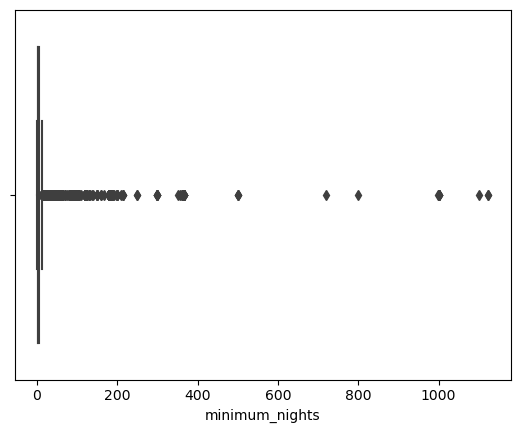

In [66]:
sns.boxplot(x = listings.minimum_nights)

In [67]:
np.nanpercentile(listings['price'], 95)

180.0

In [68]:
long_nights = listings[listings['minimum_nights']>366]
len(long_nights)

15

In [69]:
# Getting rid of the outliers and considers only the stays from 0 days to 366 days. 
listings = listings[listings['minimum_nights'] < 366]

<AxesSubplot:xlabel='minimum_nights'>

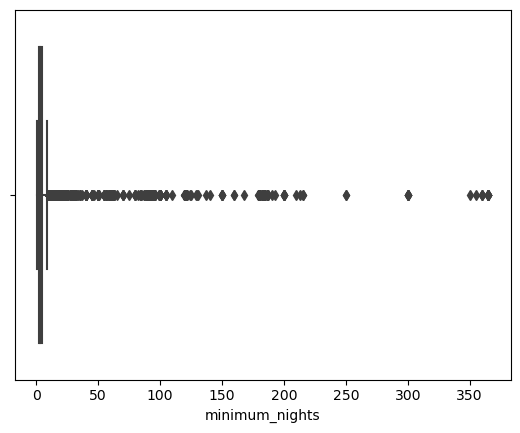

In [70]:
sns.boxplot(x = listings.minimum_nights)

In [71]:
listings.shape

(14704, 26)

##### maximum_nights

In [72]:
listings.maximum_nights.value_counts()

1125    6263
365     1673
30       719
14       623
7        433
        ... 
51         1
186        1
1130       1
302        1
178        1
Name: maximum_nights, Length: 205, dtype: int64

<AxesSubplot:xlabel='maximum_nights'>

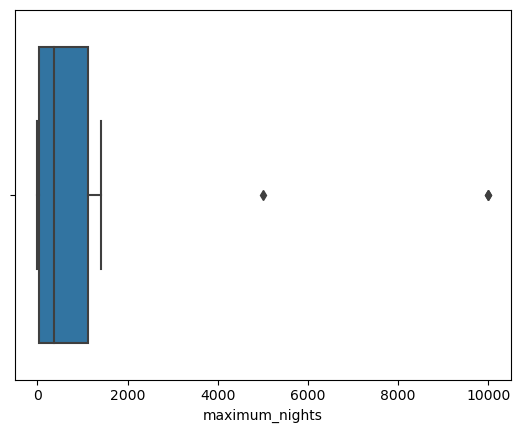

In [73]:
sns.boxplot(x = listings.maximum_nights)

Outliers above 2000 max nights need to be excluded

In [74]:
listings = listings[listings['maximum_nights']<2000]

<AxesSubplot:xlabel='maximum_nights'>

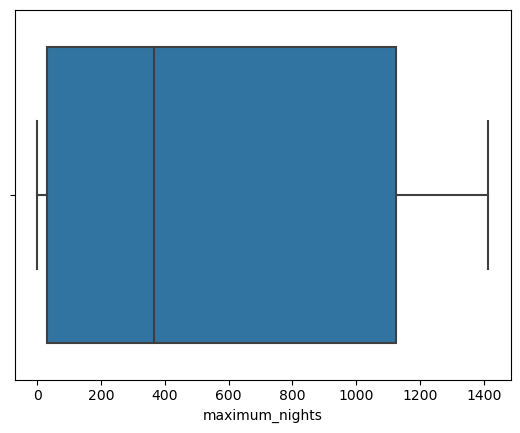

In [75]:
sns.boxplot(x = listings.maximum_nights)

##### availability_365

In [76]:
listings.availability_365.value_counts()

0      7302
365     236
364     111
1       103
6        80
       ... 
282       4
197       3
108       3
219       3
208       2
Name: availability_365, Length: 366, dtype: int64

In [77]:
# drop because some value are not available for the whole year
listings = listings.drop(['availability_365'], axis = 1)

##### number_of_reviews

In [78]:
listings[listings['number_of_reviews']==0]

,host_is_superhost,neighbourhood_group_cleansed,latitude,longitude,room_type,accommodates,bathrooms_text,bedrooms,beds,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,n_missing
18,t,Pankow,52.548800,13.404250,Entire home/apt,2,1 bath,1,1,102.0,93,1125,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7
59,f,Charlottenburg-Wilm.,52.495460,13.308580,Entire home/apt,4,1 bath,1,1,62.0,61,1125,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7
158,f,Pankow,52.555270,13.421040,Entire home/apt,2,1 bath,1,1,75.0,3,1125,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7
161,f,Charlottenburg-Wilm.,52.506210,13.304800,Private room,1,1 bath,1,1,29.0,3,90,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7
175,f,Steglitz - Zehlendorf,52.437040,13.223430,Entire home/apt,4,1 bath,2,6,89.0,60,60,30,60,90,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15712,f,Pankow,52.535704,13.433303,Entire home/apt,2,1 bath,1,1,45.0,92,178,30,60,90,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,t,7
15713,f,Tempelhof - Schöneberg,52.478550,13.348510,Private room,1,1 shared bath,1,1,31.0,30,1125,29,45,45,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7
15714,f,Friedrichshain-Kreuzberg,52.509360,13.451140,Private room,1,1 shared bath,1,1,31.0,30,1125,29,59,89,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7
15715,f,Treptow - Köpenick,52.490359,13.448729,Private room,1,1 shared bath,1,1,52.0,5,365,20,29,30,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,7


In [79]:
# If the review score rating is 0 all of the other reviews need to be 0 as well
listings = listings.assign(
    review_scores_rating=listings['review_scores_rating'].mask(listings.number_of_reviews == 0, other=0),
    review_scores_accuracy = listings['review_scores_accuracy'].mask(listings.number_of_reviews == 0, other=0),
    review_scores_cleanliness = listings['review_scores_cleanliness'].mask(listings.number_of_reviews == 0, other=0),
    review_scores_checkin = listings['review_scores_checkin'].mask(listings.number_of_reviews == 0, other=0),
    review_scores_communication = listings['review_scores_communication'].mask(listings.number_of_reviews == 0, other=0),
    review_scores_location = listings['review_scores_location'].mask(listings.number_of_reviews == 0, other=0),
    review_scores_value = listings['review_scores_value'].mask(listings.number_of_reviews == 0, other=0),
)

In [80]:
listings.number_of_reviews.value_counts()

0      2739
1      1549
2      1030
3       837
4       638
       ... 
524       1
525       1
642       1
471       1
871       1
Name: number_of_reviews, Length: 419, dtype: int64

##### review_scores_rating

In [81]:
listings.review_scores_rating.value_counts(dropna=False)

5.00    3762
0.00    2969
4.00     437
4.50     429
4.67     374
        ... 
2.83       1
3.22       1
3.95       1
3.40       1
3.58       1
Name: review_scores_rating, Length: 147, dtype: int64

<AxesSubplot:xlabel='review_scores_rating'>

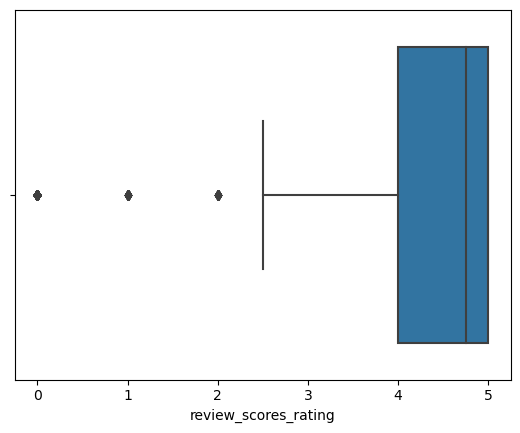

In [82]:
sns.boxplot(x=listings['review_scores_rating'])

In [83]:
score_price = listings[listings['review_scores_rating']== 0]

In [84]:
listings[listings['review_scores_rating']== 1]

,host_is_superhost,neighbourhood_group_cleansed,latitude,longitude,room_type,accommodates,bathrooms_text,bedrooms,beds,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,n_missing
782,f,Mitte,52.548600,13.348410,Private room,4,1 shared bath,1,2,36.0,3,70,0,0,0,1,1.0,3.0,1.0,4.0,4.0,5.0,1.0,f,0
2758,f,Friedrichshain-Kreuzberg,52.511260,13.473040,Entire home/apt,2,1 bath,1,1,25.0,1,1125,0,0,0,1,1.0,2.0,2.0,3.0,1.0,3.0,1.0,f,0
3613,f,Mitte,52.533770,13.346250,Entire home/apt,1,1 bath,1,1,22.0,2,1125,0,0,0,5,1.0,1.0,0.0,1.0,0.0,0.0,1.0,t,0
4093,f,Pankow,52.521510,13.463390,Entire home/apt,2,1 bath,1,2,50.0,3,1125,0,0,0,1,1.0,1.0,1.0,1.0,1.0,3.0,1.0,t,1
8984,f,Charlottenburg-Wilm.,52.519880,13.319860,Entire home/apt,2,1 bath,1,1,65.0,92,365,23,53,83,1,1.0,1.0,5.0,5.0,1.0,1.0,1.0,f,1
9277,f,Steglitz - Zehlendorf,52.422200,13.164110,Private room,2,1 private bath,1,2,98.0,2,1125,27,57,87,1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,f,0
9940,f,Mitte,52.556720,13.389410,Entire home/apt,3,1 bath,1,1,37.0,4,14,0,0,0,1,1.0,5.0,1.0,1.0,1.0,3.0,3.0,t,1
10229,f,Friedrichshain-Kreuzberg,52.504980,13.426190,Entire home/apt,2,1 bath,1,1,66.0,90,365,0,0,0,1,1.0,1.0,1.0,1.0,1.0,4.0,1.0,f,0
10477,f,Neukölln,52.466110,13.427220,Entire home/apt,3,1 bath,1,1,80.0,2,1125,0,0,0,1,1.0,1.0,1.0,3.0,3.0,3.0,2.0,t,0
10522,f,Pankow,52.577670,13.392450,Entire home/apt,4,1 bath,2,4,123.0,4,1125,11,11,11,2,1.0,1.0,1.0,1.5,2.5,2.0,1.0,t,0


In [85]:
# think about not considering those values

<AxesSubplot:xlabel='price'>

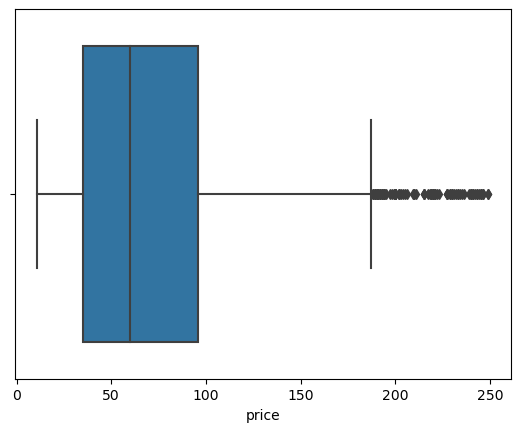

In [86]:
sns.boxplot(x=score_price['price'])

In [87]:
score_price[score_price['price']>200]

,host_is_superhost,neighbourhood_group_cleansed,latitude,longitude,room_type,accommodates,bathrooms_text,bedrooms,beds,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,n_missing
721,f,Lichtenberg,52.495600,13.482330,Entire home/apt,5,2.5 baths,3,6,210.0,1,1125,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,f,7
1390,f,Friedrichshain-Kreuzberg,52.492144,13.398156,Entire home/apt,4,1 bath,2,3,221.0,5,1125,16,46,50,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,f,7
4899,f,Friedrichshain-Kreuzberg,52.491210,13.410930,Entire home/apt,7,1 bath,3,4,240.0,6,31,1,1,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,f,7
6279,f,Charlottenburg-Wilm.,52.510300,13.322360,Entire home/apt,6,1 bath,3,3,230.0,7,28,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,f,7
6419,f,Friedrichshain-Kreuzberg,52.511270,13.456370,Entire home/apt,4,1 bath,2,2,220.0,3,1125,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,f,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15455,f,Pankow,52.530340,13.424520,Entire home/apt,9,1.5 baths,3,6,210.0,2,1125,21,51,81,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,f,7
15468,f,Charlottenburg-Wilm.,52.498500,13.326310,Entire home/apt,4,2 baths,2,2,232.0,92,365,28,58,88,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,f,7
15560,t,Charlottenburg-Wilm.,52.495860,13.312040,Entire home/apt,5,2 baths,3,3,220.0,92,365,29,59,89,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,f,7
15562,t,Charlottenburg-Wilm.,52.504390,13.303780,Entire home/apt,2,2 baths,1,1,215.0,92,365,29,59,89,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,f,7


##### bathrooms_text

In [88]:
listings['bathrooms_text'].value_counts(dropna= False)

1 bath               8755
1 shared bath        3210
1 private bath        879
1.5 baths             628
2 baths               537
1.5 shared baths      312
2 shared baths        169
2.5 baths              76
Half-bath              28
0 shared baths         26
3 baths                18
0 baths                17
2.5 shared baths       15
Shared half-bath        9
NaN                     6
4 baths                 3
8.5 shared baths        3
Private half-bath       2
3.5 baths               2
3 shared baths          2
7.5 baths               1
7 baths                 1
8 baths                 1
4 shared baths          1
Name: bathrooms_text, dtype: int64

In [89]:
# Assign mean to missing values
listings['bathrooms_text'] = listings['bathrooms_text'].fillna('1 bath')

In [90]:
listings[listings['bathrooms_text'].str.contains("shared")]

,host_is_superhost,neighbourhood_group_cleansed,latitude,longitude,room_type,accommodates,bathrooms_text,bedrooms,beds,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,n_missing
9,t,Treptow - Köpenick,52.404840,13.533390,Private room,1,1.5 shared baths,1,1,46.0,1,10,13,18,39,372,4.93,4.95,4.95,4.96,4.96,4.77,4.92,f,0
13,t,Mitte,52.528610,13.405270,Private room,2,1 shared bath,1,1,49.0,3,1125,3,8,23,223,4.90,4.92,4.82,4.90,4.96,4.97,4.84,f,0
69,f,Tempelhof - Schöneberg,52.493760,13.364080,Private room,1,1 shared bath,1,1,48.0,10,60,0,0,0,27,4.67,4.88,4.71,4.88,5.00,4.67,4.82,f,0
72,f,Spandau,52.514320,13.177650,Private room,2,1 shared bath,1,1,40.0,1,1125,0,0,0,56,4.79,4.83,4.89,4.96,4.96,4.59,4.83,f,0
76,f,Pankow,52.537800,13.412870,Private room,2,1 shared bath,1,1,43.0,15,15,0,0,0,70,4.71,4.59,4.53,4.65,4.65,4.75,4.51,f,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15699,f,Pankow,52.543540,13.412320,Private room,2,1 shared bath,1,1,40.0,3,365,15,17,17,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,t,7
15711,f,Pankow,52.550223,13.453639,Private room,2,1 shared bath,1,1,79.0,3,1125,15,41,68,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,f,7
15713,f,Tempelhof - Schöneberg,52.478550,13.348510,Private room,1,1 shared bath,1,1,31.0,30,1125,29,45,45,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,f,7
15714,f,Friedrichshain-Kreuzberg,52.509360,13.451140,Private room,1,1 shared bath,1,1,31.0,30,1125,29,59,89,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,f,7


In [91]:
# Create a new column that consits of bathrooms
def f(row):
    if "shared" in row:
        return row
    elif "Shared half-bath" == row:
        return '1.5'
    else:
        return '0'

In [92]:
listings['shared_bathrooms'] = listings['bathrooms_text'].apply(f)
listings['shared_bathrooms'].value_counts()

0                   10954
1 shared bath        3210
1.5 shared baths      312
2 shared baths        169
0 shared baths         26
2.5 shared baths       15
1.5                     9
8.5 shared baths        3
3 shared baths          2
4 shared baths          1
Name: shared_bathrooms, dtype: int64

In [93]:
listings['shared_bathrooms'] = [s.replace('shared baths', '') for s in listings['shared_bathrooms']]
listings['shared_bathrooms'] = [s.replace('shared bath', '') for s in listings['shared_bathrooms']]
listings['shared_bathrooms'].value_counts()

0       10954
1        3210
1.5       312
2         169
0          26
2.5        15
1.5         9
8.5         3
3           2
4           1
Name: shared_bathrooms, dtype: int64

In [94]:
listings['shared_bathrooms'] = listings['shared_bathrooms'].astype(float)

In [95]:
listings['shared_bathrooms'].value_counts()

0.0    10980
1.0     3210
1.5      321
2.0      169
2.5       15
8.5        3
3.0        2
4.0        1
Name: shared_bathrooms, dtype: int64

In [96]:
# Get rid of some outliers
listings = listings[listings['shared_bathrooms']<3.0]
listings['shared_bathrooms'].value_counts()

0.0    10980
1.0     3210
1.5      321
2.0      169
2.5       15
Name: shared_bathrooms, dtype: int64

In [97]:
def private_bath(row):
    if "shared" in row:
        return '0'
    elif "Shared half-bath" == row:
        return '0'
    elif "Half-bath" == row:
        return '1.5'
    elif 'Private half-bath' == row:
        return '1.5'
    else:
        return row

In [98]:
listings['private_bathrooms'] = listings['bathrooms_text'].apply(private_bath)
listings['private_bathrooms'] = [s.replace('bath', '') for s in listings['private_bathrooms']]
listings['private_bathrooms'] = [s.replace('s', '') for s in listings['private_bathrooms']]
listings['private_bathrooms'] = [s.replace('private', '') for s in listings['private_bathrooms']]
listings['private_bathrooms'] = listings['private_bathrooms'].astype(float)
listings['private_bathrooms'].value_counts()

1.0    9640
0.0    3758
1.5     658
2.0     537
2.5      76
3.0      18
4.0       3
3.5       2
7.0       1
7.5       1
8.0       1
Name: private_bathrooms, dtype: int64

In [99]:
# Remove outliers
listings = listings[listings['private_bathrooms']<3.5]
listings['private_bathrooms'].value_counts()

1.0    9640
0.0    3758
1.5     658
2.0     537
2.5      76
3.0      18
Name: private_bathrooms, dtype: int64

In [100]:
# Delete bathrooms text
listings = listings.drop(['bathrooms_text'], axis = 1)

##### review_scores_accuracy

In [101]:
listings['review_scores_accuracy'].value_counts(dropna=False)

5.00    4401
0.00    2742
4.50     317
4.67     315
4.75     304
        ... 
3.22       1
3.78       1
2.67       1
3.63       1
3.77       1
Name: review_scores_accuracy, Length: 138, dtype: int64

In [102]:
# med_acc = listings['review_scores_accuracy'].median()
# med_acc

In [103]:
mean_acc = listings['review_scores_accuracy'].mean()


<AxesSubplot:xlabel='review_scores_accuracy'>

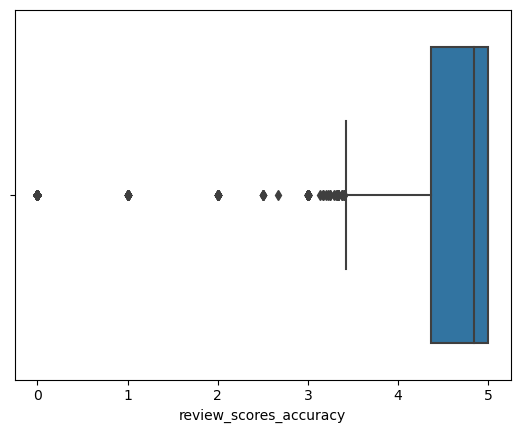

In [104]:
sns.boxplot(x = listings['review_scores_accuracy'])

In [105]:
# Assign mean to the values

#listings['review_scores_accuracy'] = listings['review_scores_accuracy'].fillna(med_acc)
listings['review_scores_accuracy'] = listings['review_scores_accuracy'].fillna(mean_acc)

In [106]:
# med_cl = listings['review_scores_cleanliness'].median()
# med_ch = listings['review_scores_checkin'].median()
# med_co = listings['review_scores_communication'].median()
# med_lo = listings['review_scores_location'].median()
# med_va = listings['review_scores_value'].median()

In [107]:
mean_cl = listings['review_scores_cleanliness'].mean()
mean_ch = listings['review_scores_checkin'].mean()
mean_co = listings['review_scores_communication'].mean()
mean_lo = listings['review_scores_location'].mean()
mean_va = listings['review_scores_value'].mean()

In [108]:
# # Fill all of the reviews with mean score
# listings['review_scores_cleanliness'] = listings['review_scores_cleanliness'].fillna(med_cl)
# listings['review_scores_checkin']= listings['review_scores_checkin'].fillna(med_ch)
# listings['review_scores_communication'] = listings['review_scores_communication'].fillna(med_co)
# listings['review_scores_location'] = listings['review_scores_location'].fillna(med_lo)
# listings['review_scores_value'] = listings['review_scores_value'].fillna(med_va)

In [109]:
# Fill all of the reviews with mean score
listings['review_scores_cleanliness'] = listings['review_scores_cleanliness'].fillna(mean_cl)
listings['review_scores_checkin']= listings['review_scores_checkin'].fillna(mean_ch)
listings['review_scores_communication'] = listings['review_scores_communication'].fillna(mean_co)
listings['review_scores_location'] = listings['review_scores_location'].fillna(mean_lo)
listings['review_scores_value'] = listings['review_scores_value'].fillna(mean_va)

In [110]:
listings['review_scores_cleanliness']

0        4.53
1        5.00
3        4.84
4        4.77
5        4.58
         ... 
15712    0.00
15713    0.00
15714    0.00
15715    0.00
15716    0.00
Name: review_scores_cleanliness, Length: 14687, dtype: float64

In [111]:
listings['review_scores_cleanliness'] = pd.to_numeric(listings['review_scores_cleanliness'], errors = 'coerce')
listings['review_scores_checkin'] = pd.to_numeric(listings['review_scores_checkin'], errors = 'coerce')
listings['review_scores_communication'] = pd.to_numeric(listings['review_scores_communication'], errors = 'coerce')
listings['review_scores_location'] = pd.to_numeric(listings['review_scores_location'], errors = 'coerce')
listings['review_scores_value'] = pd.to_numeric(listings['review_scores_value'], errors = 'coerce')

In [112]:
listings.isna().sum()

host_is_superhost               0
neighbourhood_group_cleansed    0
latitude                        0
longitude                       0
room_type                       0
accommodates                    0
bedrooms                        0
beds                            0
price                           0
minimum_nights                  0
maximum_nights                  0
availability_30                 0
availability_60                 0
availability_90                 0
number_of_reviews               0
review_scores_rating            0
review_scores_accuracy          0
review_scores_cleanliness       0
review_scores_checkin           0
review_scores_communication     0
review_scores_location          0
review_scores_value             0
instant_bookable                0
n_missing                       0
shared_bathrooms                0
private_bathrooms               0
dtype: int64

In [113]:
listings.dtypes

host_is_superhost                object
neighbourhood_group_cleansed     object
latitude                        float64
longitude                       float64
room_type                        object
accommodates                      int64
bedrooms                          int64
beds                              int64
price                           float64
minimum_nights                    int64
maximum_nights                    int64
availability_30                   int64
availability_60                   int64
availability_90                   int64
number_of_reviews                 int64
review_scores_rating            float64
review_scores_accuracy          float64
review_scores_cleanliness       float64
review_scores_checkin           float64
review_scores_communication     float64
review_scores_location          float64
review_scores_value             float64
instant_bookable                 object
n_missing                         int64
shared_bathrooms                float64


In [114]:
listings.describe().T

,count,mean,std,min,25%,50%,75%,max
latitude,14687.0,52.509818,0.032628,52.36904,52.489550,52.50944,52.532770,52.65611
longitude,14687.0,13.404949,0.062797,13.10899,13.368485,13.41501,13.439282,13.72139
accommodates,14687.0,2.658337,1.419297,1.00000,2.000000,2.00000,3.000000,14.00000
bedrooms,14687.0,1.220195,0.526299,1.00000,1.000000,1.00000,1.000000,5.00000
beds,14687.0,1.642541,1.082003,1.00000,1.000000,1.00000,2.000000,8.00000
price,14687.0,76.863321,48.016336,11.00000,40.000000,65.00000,100.000000,249.00000
minimum_nights,14687.0,13.338122,31.230340,1.00000,2.000000,3.00000,5.000000,365.00000
maximum_nights,14687.0,556.599510,511.401298,1.00000,30.000000,365.00000,1125.000000,1414.00000
availability_30,14687.0,6.096616,9.478711,0.00000,0.000000,0.00000,11.000000,30.00000
availability_60,14687.0,13.885613,20.483403,0.00000,0.000000,0.00000,26.000000,60.00000


In [115]:
listings = listings.drop(['n_missing'], axis = 1)

In [116]:
listings.shape

(14687, 25)

In [117]:
listings = listings.drop_duplicates()

In [118]:
listings.shape

(14685, 25)

#### 3.2 Export cleaned csv file

In [119]:
listings.to_csv("listings_cleaned.csv")

## 4. EDA

In [120]:
import pandas_profiling

In [121]:
overview = listings.profile_report

In [122]:
profile = listings.profile_report(title='Pandas Profiling Report')
profile.to_file(output_file="listings data profiling.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [123]:
profile

Main EDA can be found in my tableau dashboard
- https://public.tableau.com/app/profile/anna.heins/viz/airbnb-finalproject/Neighbourhoodsandprediction?publish=yes

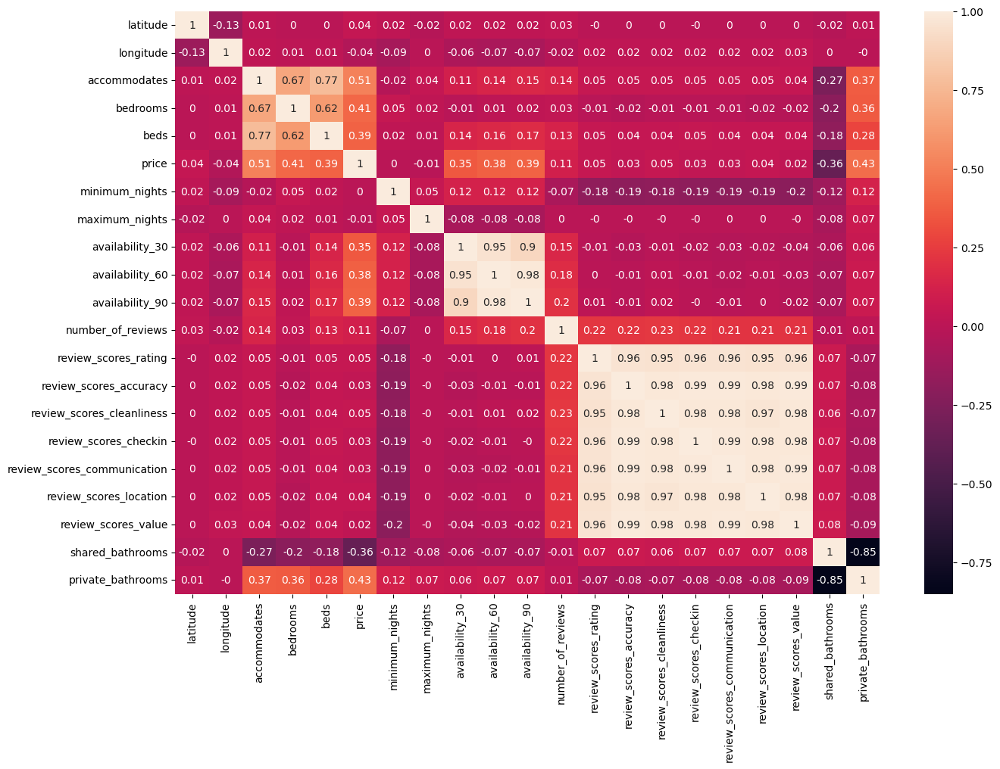

In [124]:
correlation_matrix = listings.corr().round(2)
correlation_matrix

fig, corr_heatmap=plt.subplots(figsize=(15,10))
corr_heatmap = sns.heatmap(correlation_matrix, annot=True)
plt.show()

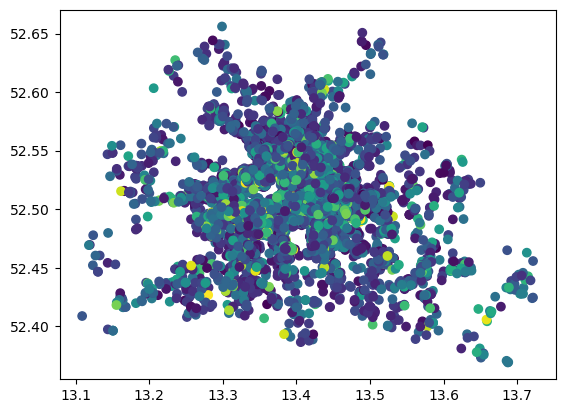

In [125]:
#check out where the airbnbs are located

plt.scatter(listings['longitude'], listings['latitude'], c=listings['price'], cmap = 'viridis')

In [126]:
# get rid of the reviews and only keep the overall rating
listings_model = listings.drop(['review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication', 'review_scores_location', 'review_scores_value'], axis = 1)

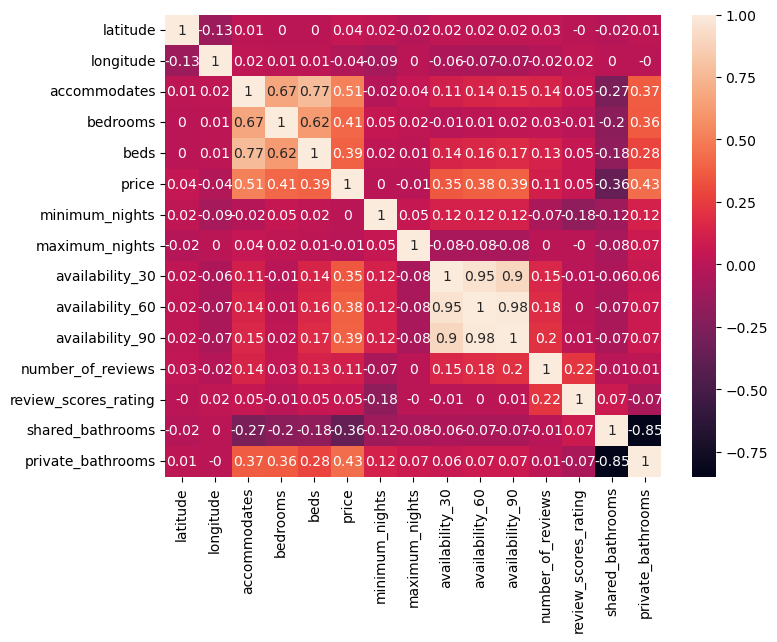

In [127]:
correlation_matrix = listings_model.corr().round(2)
correlation_matrix

fig, corr_heatmap=plt.subplots(figsize=(8,6))
corr_heatmap = sns.heatmap(correlation_matrix, annot=True)
plt.show()

In [128]:
# Get rid of availability_30 & availability_60 to avoid multicollinearity
listings_model = listings.drop(['availability_30', 'availability_60'], axis = 1)

In [129]:
listings_model = listings.drop(['latitude', 'longitude'], axis = 1)

In [130]:
listings_model.dtypes

host_is_superhost                object
neighbourhood_group_cleansed     object
room_type                        object
accommodates                      int64
bedrooms                          int64
beds                              int64
price                           float64
minimum_nights                    int64
maximum_nights                    int64
availability_30                   int64
availability_60                   int64
availability_90                   int64
number_of_reviews                 int64
review_scores_rating            float64
review_scores_accuracy          float64
review_scores_cleanliness       float64
review_scores_checkin           float64
review_scores_communication     float64
review_scores_location          float64
review_scores_value             float64
instant_bookable                 object
shared_bathrooms                float64
private_bathrooms               float64
dtype: object

In [131]:
#listings_model = listings_model.drop(['host_is_superhost','neighbourhood_group_cleansed','availability_30','private_bathrooms'],axis = 1)

In [132]:
listings_model.shape

(14685, 23)

In [133]:
categorical = listings_model.select_dtypes(object)

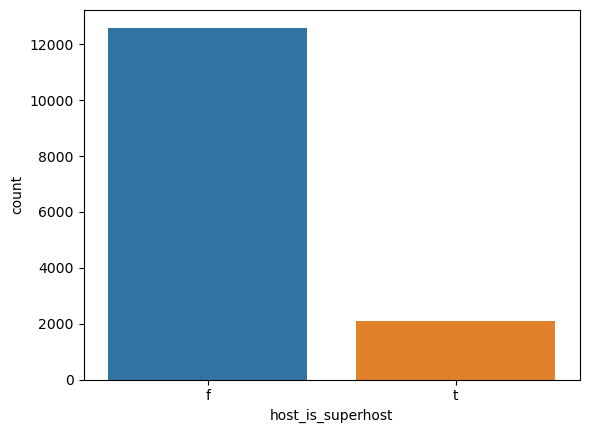

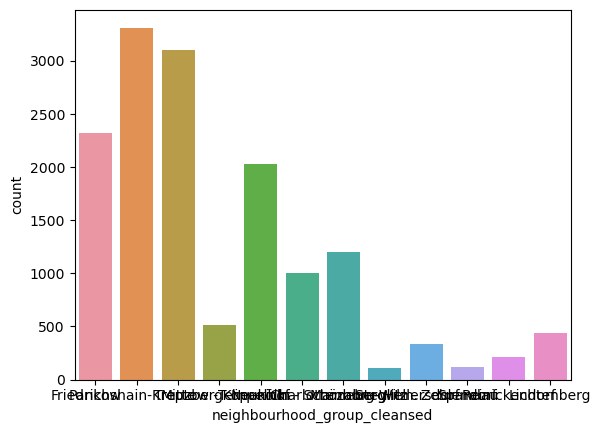

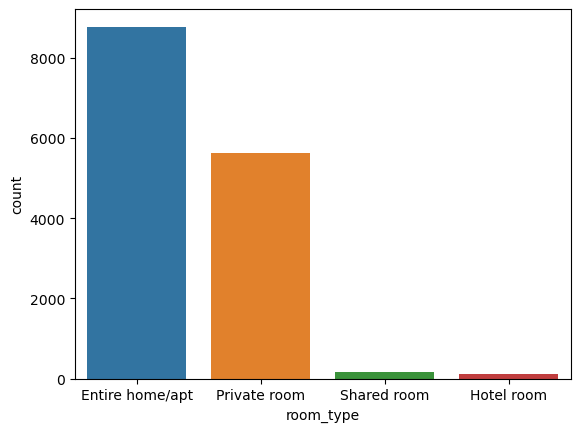

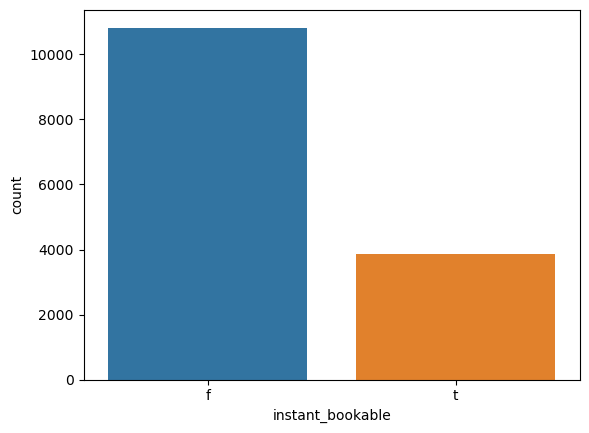

In [134]:
for col in categorical:
    sns.countplot(x=categorical[col])
    plt.show()

In [135]:
numerical_int = listings_model.select_dtypes(int)
numerical_float = listings_model.select_dtypes(float)

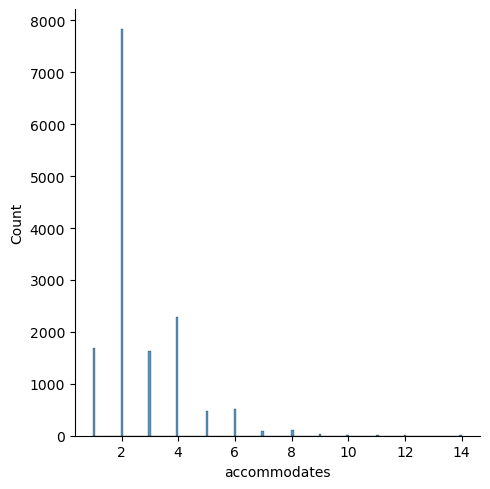

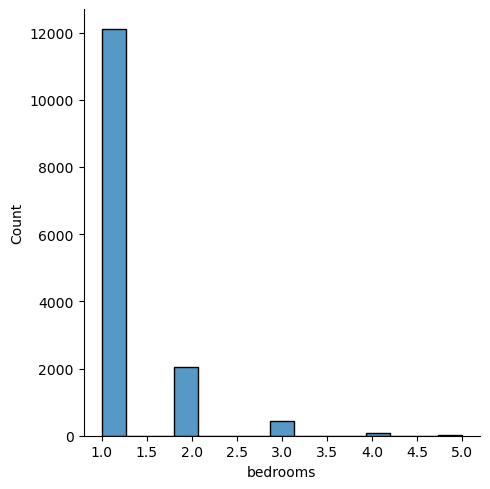

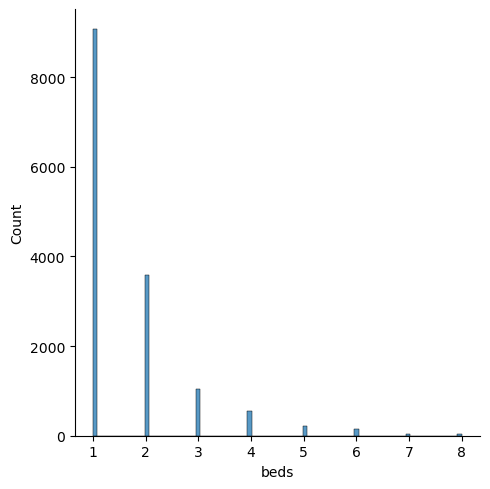

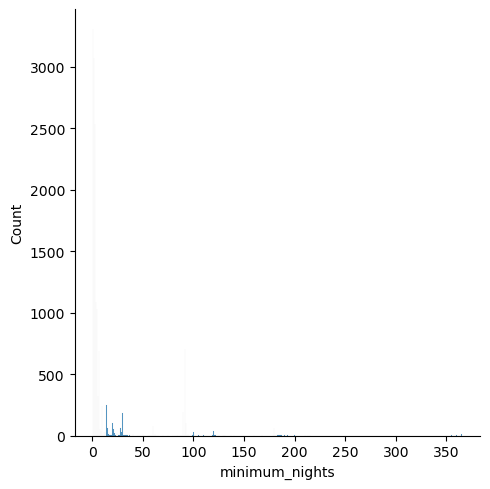

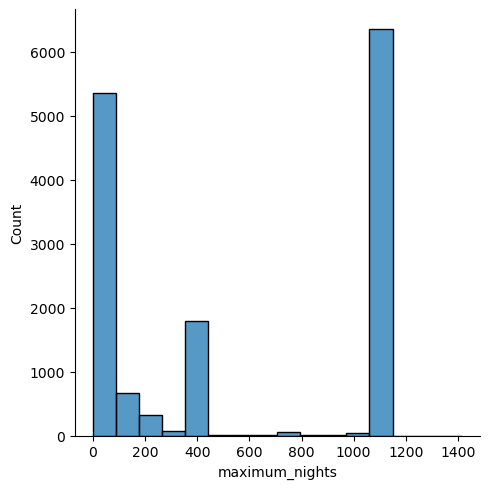

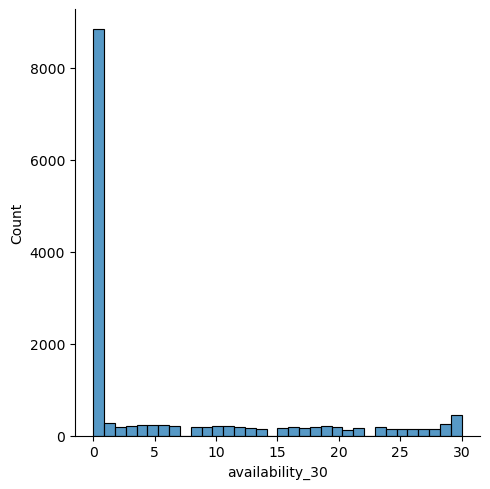

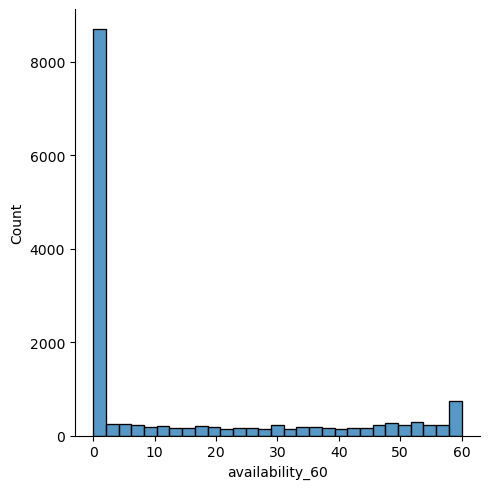

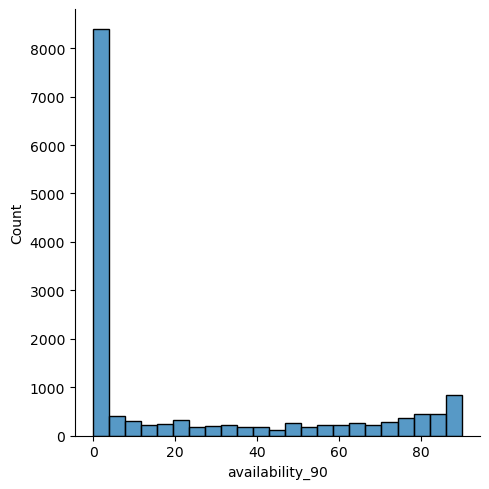

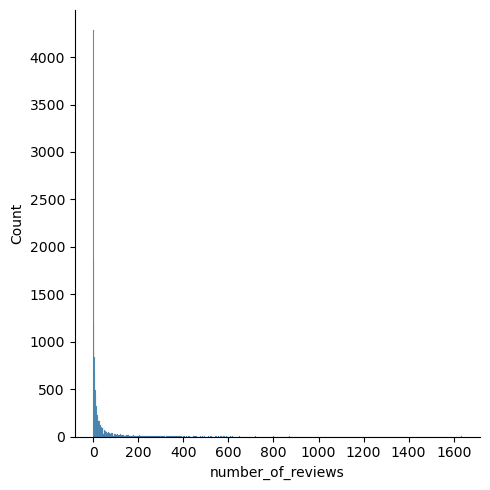

In [136]:
for col in numerical_int:
    sns.displot(x=numerical_int[col])
    plt.show()

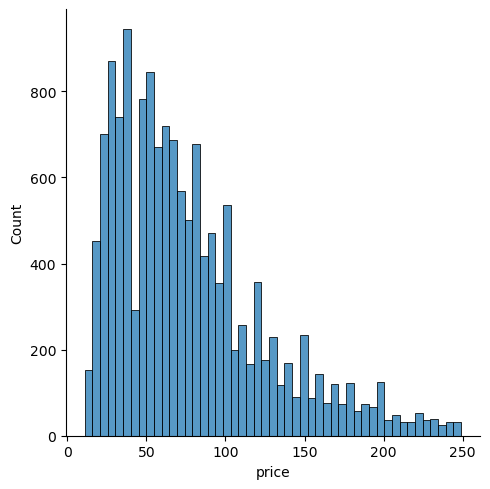

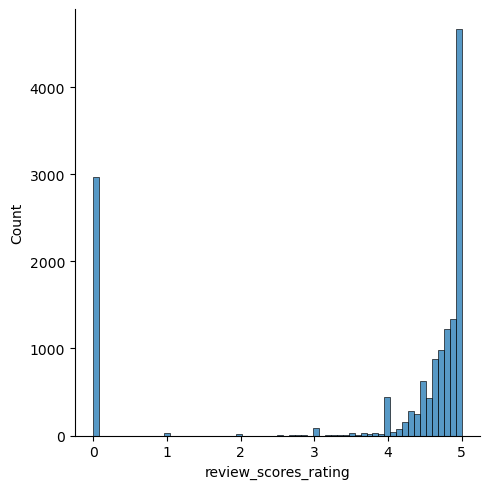

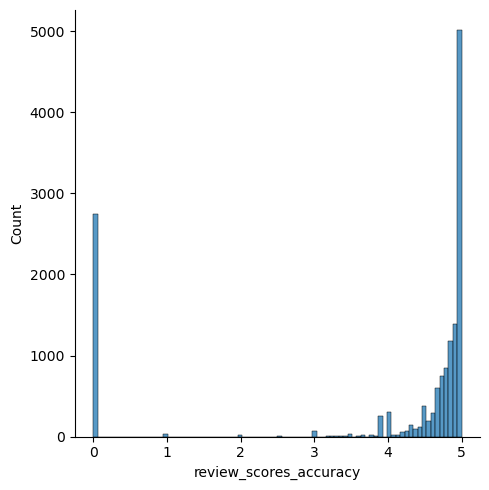

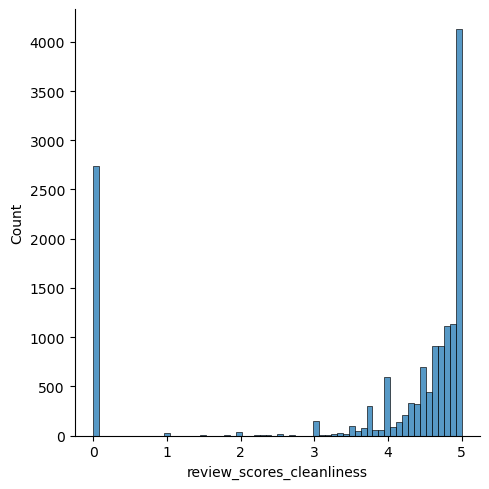

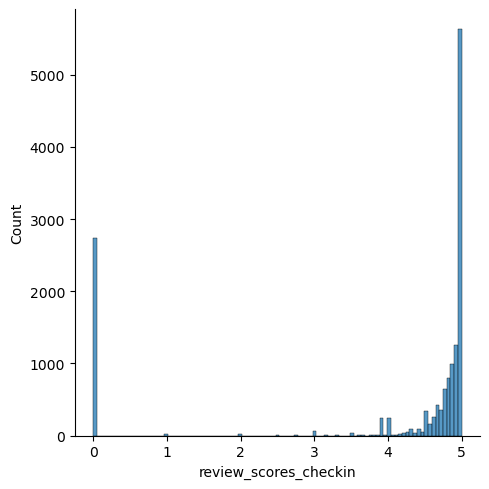

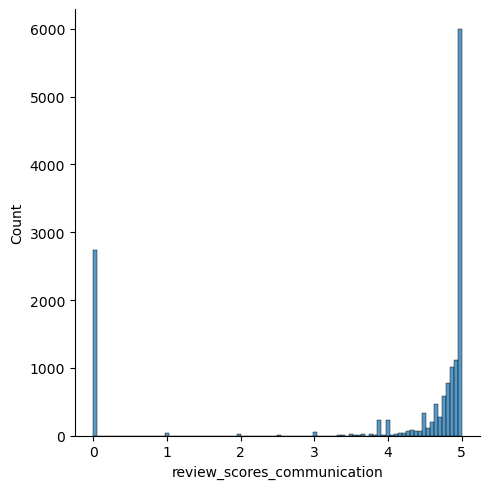

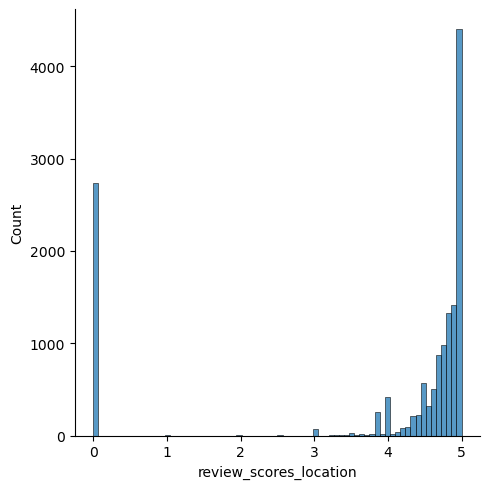

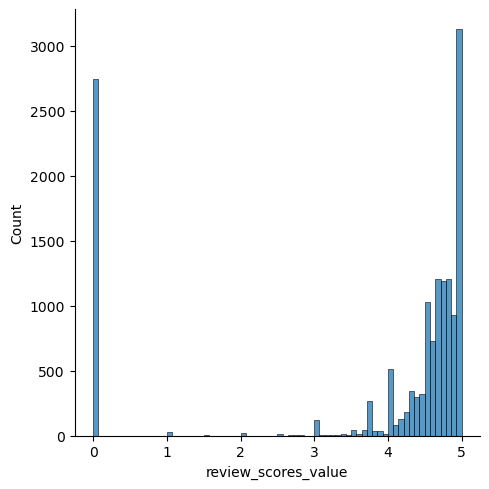

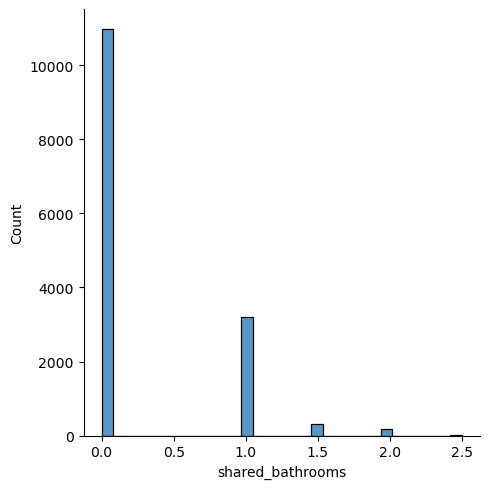

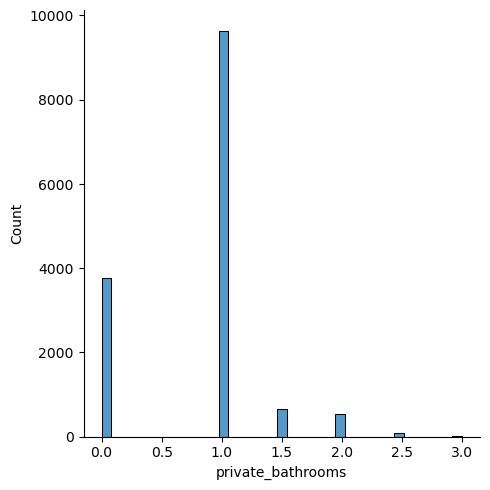

In [137]:
for col in numerical_float:
    sns.displot(x=numerical_float[col])
    plt.show()

**Comment**: There are a few values that are zero but this is because either the accommodation is new and does not have any reviews yet or we need to differentiate between private and shared bathrooms

## 5. Preparing for the model 

In [138]:
y = listings_model['price']
X = listings_model.drop(['price'], axis = 1)

In [139]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

#### 5.1. train_test_split

In [140]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=100)

display(X_train.shape)
display(X_test.shape)
display(y_train.shape)
display(y_test.shape)

(11748, 22)

(2937, 22)

(11748,)

(2937,)

#### 5.2. Normalize the numerical variables

In [141]:
numericals_train = X_train.select_dtypes(np.number)
numericals_test = X_test.select_dtypes(np.number)
numericals_train.head()

,accommodates,bedrooms,beds,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,shared_bathrooms,private_bathrooms
7783,3,3,3,1,1125,0,0,22,12,4.42,4.33,3.58,4.83,5.00,4.83,4.33,1.0,0.0
9624,2,1,1,1,1125,23,52,82,33,4.61,4.88,4.70,4.94,4.82,4.82,4.58,0.0,1.0
3687,2,1,1,2,6,0,0,0,13,4.92,4.92,4.92,5.00,4.83,4.73,4.82,0.0,1.5
8920,3,1,1,3,365,0,0,0,7,4.86,5.00,4.57,4.86,4.86,4.86,4.71,0.0,1.0
14387,4,2,3,1,365,12,42,72,23,4.26,4.39,4.26,4.74,4.48,4.83,4.39,0.0,1.0


In [142]:
#from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

# Create a transformer that can be pickled
transformer = MinMaxScaler().fit(numericals_train)
numericals_train_standardized = transformer.transform(numericals_train)
numericals_test_standardized = transformer.transform(numericals_test)

In [143]:
pd.DataFrame(numericals_train_standardized).head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,0.153846,0.50,0.285714,0.000000,0.795471,0.000000,0.000000,0.244444,0.007339,0.884,0.866,0.716,0.966,1.000,0.966,0.866,0.4,0.000000
1,0.076923,0.00,0.000000,0.000000,0.795471,0.766667,0.866667,0.911111,0.020183,0.922,0.976,0.940,0.988,0.964,0.964,0.916,0.0,0.333333
2,0.076923,0.00,0.000000,0.002747,0.003539,0.000000,0.000000,0.000000,0.007951,0.984,0.984,0.984,1.000,0.966,0.946,0.964,0.0,0.500000
3,0.153846,0.00,0.000000,0.005495,0.257608,0.000000,0.000000,0.000000,0.004281,0.972,1.000,0.914,0.972,0.972,0.972,0.942,0.0,0.333333
4,0.230769,0.25,0.285714,0.000000,0.257608,0.400000,0.700000,0.800000,0.014067,0.852,0.878,0.852,0.948,0.896,0.966,0.878,0.0,0.333333


#### 5.3 Encode the categorical variables

In [144]:
categoricals_train= X_train.select_dtypes(object)
categoricals_test= X_test.select_dtypes(object)
categoricals_train.head()

,host_is_superhost,neighbourhood_group_cleansed,room_type,instant_bookable
7783,f,Friedrichshain-Kreuzberg,Private room,f
9624,f,Pankow,Hotel room,t
3687,f,Pankow,Private room,t
8920,f,Pankow,Entire home/apt,f
14387,f,Mitte,Entire home/apt,f


In [145]:
from sklearn.preprocessing import OneHotEncoder

encoder = OneHotEncoder(handle_unknown='error', drop='first').fit(categoricals_train)
train_encoded = encoder.transform(categoricals_train).toarray()
test_encoded = encoder.transform(categoricals_test).toarray()


In [146]:
X_train_processed = np.concatenate((numericals_train_standardized, train_encoded), axis = 1)
X_test_processed = np.concatenate((numericals_test_standardized, test_encoded), axis = 1)

## 6. Build the model

In [147]:
from sklearn import linear_model
from sklearn.metrics import r2_score
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import cross_val_score
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_absolute_error

In [148]:
#### 6.1 Linear Regression

lm = linear_model.LinearRegression()
lm.fit(X_train_processed,y_train)

lm_predict = lm.predict(X_train_processed) 
r2_score(y_train, lm_predict)

lm_pred_test = lm.predict(X_test_processed)
print("Linear Regression model" ,r2_score(y_test, lm_pred_test))

#### 6.2 KNeigborsRegressor

from sklearn.neighbors import KNeighborsRegressor
KNN = KNeighborsRegressor(n_neighbors=19)
KNN.fit(X_train_processed, y_train)
score_knn = KNN.score(X_test_processed, y_test)

knn_pred_test = KNN.predict(X_test_processed)
print('KNeighborsRegressor', knn_pred_test)

#### 6.3 RandomForestRegressor

from sklearn.ensemble import RandomForestRegressor

reg = RandomForestRegressor(n_estimators = 100,
                           min_samples_split = 6,
                           min_samples_leaf = 4,
                           max_features = 'sqrt',
                           max_depth = 120,
                           bootstrap = False)
reg.fit(X_train_processed, y_train)

rf_pred_test = reg.predict(X_test_processed)
print('Random Forest Regressor', rf_pred_test)

#### 6.4 DecisionTreeRegressor

regr = DecisionTreeRegressor() 
#                            all of the parameters are default values
# max_depth - number of questions that you will ask for each point
# max_features - how many features can you use throughout those questions
model = regr.fit(X_train_processed, y_train)
print("test data accuracy was: ",regr.score(X_test_processed, y_test))
print("train data accuracy was: ",regr.score(X_train_processed, y_train))

dt_pred_test = regr.predict(X_test_processed)
print('DecisionTreeRegressor',dt_pred_test)

Linear Regression model 0.5361041435288374
KNeighborsRegressor [63.73684211 73.47368421 67.84210526 ... 35.21052632 39.52631579
 46.52631579]
Random Forest Regressor [87.29146244 96.52244671 75.20190227 ... 48.78313535 35.17844254
 68.73754443]
test data accuracy was:  0.2026526281614749
train data accuracy was:  0.9937817631586883
DecisionTreeRegressor [119.  30.  40. ...  49.  30. 119.]


#### 6.1 Hyperparameter
Optimize the parameters for the RandomForestRegressor and DecisionTreeRegressor

##### RandomForestRegressor

In [149]:
n_estimators = [5,20,50,100] # number of trees in the random forest
max_features = ['auto', 'sqrt'] # number of features in consideration at every split
max_depth = [int(x) for x in np.linspace(10, 120, num = 12)] # maximum number of levels allowed in each decision tree
min_samples_split = [2, 6, 10] # minimum sample number to split a node
min_samples_leaf = [1, 3, 4] # minimum sample number that can be stored in a leaf node
bootstrap = [True, False] # method used to sample data points

random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}


In [150]:
## Importing Random Forest Classifier from the sklearn.ensemble
from sklearn.ensemble import RandomForestRegressor
rf = RandomForestRegressor()

from sklearn.model_selection import RandomizedSearchCV
rf_random = RandomizedSearchCV(estimator = rf,param_distributions = random_grid, n_iter = 100, cv = 5, verbose=2, random_state=35, n_jobs = -1)

In [151]:
rf_random.fit(X_train_processed, y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestR

/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestR

/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestR

/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestR

/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestR

/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestR

/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestR

/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestR

/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestR

/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:414: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestR

RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [10, 20, 30, 40, 50, 60,
                                                      70, 80, 90, 100, 110,
                                                      120],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 3, 4],
                                        'min_samples_split': [2, 6, 10],
                                        'n_estimators': [5, 20, 50, 100]},
                   random_state=35, verbose=2)

In [152]:
print ('Best Parameters: ', rf_random.best_params_, ' \n')

Best Parameters:  {'n_estimators': 100, 'min_samples_split': 6, 'min_samples_leaf': 3, 'max_features': 'sqrt', 'max_depth': 40, 'bootstrap': False}  



##### DecisionTreeRegressor

In [153]:
max_depth_choices= [3,4,5,6,7,8,9,10,None]
criterion_choices = ['squared_error','absolute_error']
min_samples_split_choices = [2,3,4,5,6,7,8,9,10]
min_samples_leaf_choices = [2,3,4,5,6,7,8,9,10]
max_features_choices = [2,3,4,5,6]



random_grid = {'max_depth': max_depth_choices,
               'criterion': criterion_choices,
               'min_samples_split': min_samples_split_choices,
               'min_samples_leaf': min_samples_leaf_choices,
               'max_features': max_features_choices}

In [154]:
model = DecisionTreeRegressor()
random_search = RandomizedSearchCV(estimator = model, param_distributions = random_grid, n_iter=100, cv = 5, n_jobs = -1) #n_jobs = split the work over the processors


In [155]:
random_search.fit(X_train_processed,y_train)

RandomizedSearchCV(cv=5, estimator=DecisionTreeRegressor(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'criterion': ['squared_error',
                                                      'absolute_error'],
                                        'max_depth': [3, 4, 5, 6, 7, 8, 9, 10,
                                                      None],
                                        'max_features': [2, 3, 4, 5, 6],
                                        'min_samples_leaf': [2, 3, 4, 5, 6, 7,
                                                             8, 9, 10],
                                        'min_samples_split': [2, 3, 4, 5, 6, 7,
                                                              8, 9, 10]})

In [156]:
random_search.best_params_

{'min_samples_split': 2,
 'min_samples_leaf': 7,
 'max_features': 6,
 'max_depth': 9,
 'criterion': 'squared_error'}

#### 6.2. Feature Selection

In [157]:
from sklearn.feature_selection import VarianceThreshold 
var_threshold = 0.02 #value between 0 and 1. Experiment with the value
# How high should the variance be?
sel = VarianceThreshold(threshold=(var_threshold)) #var_threshold in () to say that we want to use it for every column, could also do it for each column individually


In [158]:
# This drops the columns that have a variance less than this threshold
sel = sel.fit(X_train_processed)
temp = sel.transform(X_train_processed)
temp = pd.DataFrame(temp)
print(X_train_processed.shape)
print(temp.shape)

(11748, 34)
(11748, 25)


In [159]:
sel.variances_ > var_threshold
sel.get_support()
var_list = list(sel.get_support())
var_list

# List comprehension, produce a list of features that we should remove, only if the second calue is False
print([col[0] for col in zip(categoricals_train.columns, var_list) if col[1] == False])
[col[0] for col in zip(numericals_train.columns, var_list) if col[1] == False]

['host_is_superhost', 'neighbourhood_group_cleansed', 'instant_bookable']


['accommodates', 'bedrooms', 'minimum_nights', 'number_of_reviews']

As a quick shot I tested if the feature selection will have a significant improvement in the model. It turned out that the feature selection did not significantly improve the model. Therefore it will not be considered further in the presentation of the results.

#### 6.3. Prepare the model

In [162]:
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error

In [163]:
def run_pipeline_regr(X_train_progressed, X_test_progressed, y_train,y_test):
    linreg = LinearRegression()
    dtreg = DecisionTreeRegressor(max_depth=9,
                             criterion = 'squared_error', # means MSE, is the default value
                             min_samples_split=10, 
                             min_samples_leaf = 6,
                             max_features = 6)
    knreg = KNeighborsRegressor(n_neighbors=36)
    mlp = MLPRegressor(max_iter = 700)
    rfreg = RandomForestRegressor(n_estimators = 100,
                           min_samples_split = 6,
                           min_samples_leaf = 3,
                           max_features = 'sqrt',
                           max_depth = 40,
                           bootstrap = False)

    model_pipeline = [linreg, dtreg, knreg, mlp, rfreg]
    model_name = ["linreg","decision_tree_reg","knn_reg", 'mlp', 'rfreq']
    
    preds_train = {}
    preds_test = {}
    scores_train = {}
    scores_test = {}
    mses_train = {}
    mses_test = {}
    rmses_train = {}
    rmses_test = {}
    maes_train = {}
    maes_test = {}
    for i,j in zip(model_pipeline, model_name):
        i.fit(X_train_progressed, y_train)
        pred_train = i.predict(X_train_progressed)
        preds_train[j] = pred_train
        pred_test = i.predict(X_test_progressed)
        preds_test[j] = pred_test

        mean_score_train = np.mean(cross_val_score(i, X_train_progressed, y_train, cv = 5))
        scores_train[j] = mean_score_train
        mean_score_test = np.mean(cross_val_score(i, X_test_progressed, y_test, cv = 5))
        scores_test[j] = mean_score_test

        mse_train = mean_squared_error(pred_train, y_train)
        mse_test = mean_squared_error(pred_test, y_test)
        rmse_train = np.sqrt(mse_train)
        rmse_test = np.sqrt(mse_test)
        mae_train = mean_absolute_error(pred_train, y_train)
        mae_test = mean_absolute_error(pred_test, y_test)

        mses_train[j] = mse_train
        mses_test[j] = mse_test
        rmses_train[j] = rmse_train
        rmses_test[j] = rmse_test
        maes_train[j] = mae_train
        maes_test[j] = mae_test 

    return preds_train, scores_train, mses_train, rmses_train, maes_train , preds_test,  scores_test,  mses_test,  rmses_test,  maes_test

### 7. Results - Predicting prices of airbnbs

In [164]:
preds_train, scores_train, mses_train, rmses_train, maes_train , preds_test,  scores_test,  mses_test,  rmses_test,  maes_test = run_pipeline_regr(X_train_processed, X_test_processed, y_train, y_test)

/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (700) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (700) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (700) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (700) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multi

In [165]:
print(rmses_test)

{'linreg': 32.72562481402252, 'decision_tree_reg': 34.73460799850708, 'knn_reg': 35.27200830879137, 'mlp': 30.82371855064498, 'rfreq': 29.999212378759665}


In [166]:
print(maes_test)

{'linreg': 24.50800869111129, 'decision_tree_reg': 25.272742228423326, 'knn_reg': 25.629143305716344, 'mlp': 22.620227061174912, 'rfreq': 21.881411971331904}


In [167]:
listings_model.head(2)

,host_is_superhost,neighbourhood_group_cleansed,room_type,accommodates,bedrooms,beds,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,shared_bathrooms,private_bathrooms
0,f,Pankow,Entire home/apt,4,1,2,83.0,63,184,3,3,5,147,4.63,4.68,4.53,4.64,4.69,4.92,4.63,f,0.0,1.0
1,f,Pankow,Entire home/apt,7,4,7,180.0,6,14,0,0,0,8,5.00,5.00,5.00,5.00,5.00,4.86,4.86,f,0.0,2.5


#### 7.1 Put the predictions into a new DataFrame

In [168]:
prediction = pd.DataFrame(preds_test['rfreq'])
prediction

,0
0,89.268962
1,103.830677
2,71.653321
3,81.936484
4,26.984474
...,...
2932,32.219674
2933,93.811726
2934,47.252922
2935,35.775391


In [169]:
results = y_test
results = results.reset_index()

In [170]:
final_results = np.concatenate((results, prediction), axis = 1)

In [171]:
final_results = pd.DataFrame(final_results)
final_results.columns = ['index', 'actual_results', 'pred_results']
final_results

,index,actual_results,pred_results
0,4324.0,70.0,89.268962
1,11510.0,79.0,103.830677
2,11437.0,45.0,71.653321
3,2255.0,175.0,81.936484
4,4810.0,17.0,26.984474
...,...,...,...
2932,3010.0,21.0,32.219674
2933,5026.0,78.0,93.811726
2934,924.0,35.0,47.252922
2935,9246.0,24.0,35.775391


In [172]:
final_results.to_csv("final_results.csv")

<AxesSubplot:xlabel='actual_results', ylabel='pred_results'>

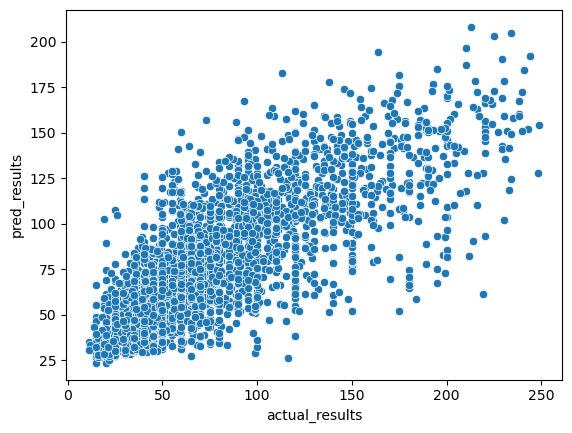

In [173]:
sns.scatterplot(data = final_results, x ='actual_results', y='pred_results')

Check out my tableau to get a deeper understanding of the evaluation of the predictions. 
- https://public.tableau.com/app/profile/anna.heins/viz/airbnb-finalproject/Neighbourhoodsandprediction?publish=yes

Further steps would be to **optimize the model** and get **additional features** such as sqm per appartment, neighbourhood criterias to improve the model and **build a price recommendation service for landlords** that want to open an airbnb in Berlin.